In [1]:
from typing import Dict, Iterable, Optional

import numpy as np
import torch
import scanpy as sc

from torch.distributions import Normal, Poisson
from torch.distributions import kl_divergence as kld
from torch import tensor
# from complementary_models import HALOMASKVIR_ALN as HALOVI
# from complementary_models import HALOMASKVAE_ALN as HALOVAE

from complementary_models import HALOMASKVIR as HALOVI
from complementary_models import HALOMASKVAE as HALOVAE
import scvi
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import scipy


Global seed set to 0


## Data Preprocess

In [2]:
adata_multi = sc.read_10x_mtx('./data/datasets/NEAT_Seq/outputs/RNA_ATAC/',gex_only=False)
metadata = pd.read_csv('./data/datasets/NEAT_Seq/outputs/metadata.csv',index_col = 0)
adata_multi.obs = pd.merge(adata_multi.obs, metadata, left_index=True, right_index=True)

In [13]:
adata_mvi = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/multiome_interim.h5ad")

In [14]:
adata_mvi = sc.read_h5ad("data/datasets/NEAT_Seq/neat_multiome.h5ad")

In [8]:
rna_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF_v1.h5ad")

In [3]:
Cluster_color = {
                "Act.": "#D51F26",
                "Treg": "#272E6A",
                "Th17": "#208A42",
                "Tcm": "#89288F",
                "Th2": "#F47D2B",
                "Th1": "#FEE500",
                "Uncom.": "#8A9FD1"    
                }


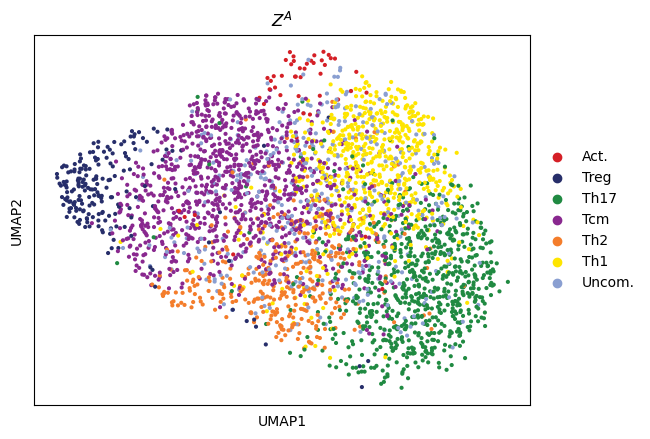

In [34]:
sc.pl.umap(rna_data,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()

In [3]:
adata_multi = adata_multi[adata_multi.obs.ReadsInPeaks > 4000, :]

In [4]:
sc.pp.filter_genes(adata_multi, min_cells=10)

/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


In [3]:
adata_multi.obs["batch_id"] = 1
adata_multi.var["modality"] =adata_multi.var["feature_types"]
adata_multi.var["modality"].value_counts()
adata_mvi = scvi.data.organize_multiome_anndatas(adata_multi)
adata_mvi 

NameError: name 'adata_multi' is not defined

In [6]:
adata_mvi.obs['Clusters'] = adata_mvi.obs['Clusters'].astype(str).astype('category')
old_to_new = dict(
    C1='Act.',
    C2='Treg',
    C3='Th17',
    C4='Tcm',
    C5='Th2',
    C6='Th1',
    C7='Uncom.'
)
adata_mvi.obs['new_clusters'] = (
    adata_mvi.obs['Clusters']
    .map(old_to_new)
    .astype('category')
)


Tcm       1004
Th17       758
Th1        611
Uncom.     390
Th2        372
Treg       190
Act.        45
Name: new_clusters, dtype: int64

In [3]:

Cluster_color = {
                "Act.": "#D51F26",
                "Treg": "#272E6A",
                "Th17": "#208A42",
                "Tcm": "#89288F",
                "Th2": "#F47D2B",
                "Th1": "#FEE500",
                "Uncom.": "#8A9FD1"    
                }



In [ ]:
# adata_mvi.obs['GATA3-norm'] = (adata_mvi.obs['GATA3-norm'] - adata_mvi.obs['GATA3-norm'].min()) / (adata_mvi.obs['GATA3-norm'].max() - adata_mvi.obs['GATA3-norm'].min())
adata_mvi.obs['new_clusters'].value_counts()

In [8]:
adata_mvi.write_h5ad("./data/datasets/NEAT_Seq/outputs/multiome_interim.h5ad")

In [7]:
adata_mvi.obs["GATA3_norm2"] = (adata_mvi.obs['GATA3-norm'] - adata_mvi.obs['GATA3-norm'].min()) / (adata_mvi.obs['GATA3-norm'].max() - adata_mvi.obs['GATA3-norm'].min())
adata_mvi.obs

,orig.ident,nCount_RNA,nFeature_RNA,cell_id,Sample,TSSEnrichment,ReadsInTSS,ReadsInPromoter,ReadsInBlacklist,PromoterRatio,...,Phase,FOXP3-norm,Helios-norm,Tbet-norm,GATA3-norm,RORgT-norm,batch_id,modality,new_clusters,GATA3_norm2
lane1#AAACCAACATAGCGAG-1_paired,CD4,1524,981,lane1#AAACCAACATAGCGAG-1,lane1,14.800,3311,3239,69,0.342389,...,G1,4.521461,2.374094,4.521461,6.523628,3.380484,1,paired,Th1,0.700634
lane1#AAACCAACATTCAGCA-1_paired,CD4,2193,1180,lane1#AAACCAACATTCAGCA-1,lane1,20.063,3536,3373,60,0.395057,...,G1,5.264722,1.071297,3.937079,5.595648,3.447830,1,paired,Th1,0.546231
lane1#AAACCGAAGGCTGTCA-1_paired,CD4,1713,1013,lane1#AAACCGAAGGCTGTCA-1,lane1,17.184,4339,4078,102,0.335417,...,G1,4.513785,3.801674,4.169147,5.481858,2.901589,1,paired,Th1,0.527298
lane1#AAACCGGCAAGGGTTG-1_paired,CD4,1504,922,lane1#AAACCGGCAAGGGTTG-1,lane1,16.222,4055,3791,70,0.372836,...,G2M,4.594908,3.538260,4.904847,5.593871,2.955454,1,paired,Th1,0.545935
lane1#AAACGGATCCTGTTCA-1_paired,CD4,2657,1336,lane1#AAACGGATCCTGTTCA-1,lane1,14.653,3981,3943,64,0.355866,...,S,4.545828,2.958855,3.390268,4.976721,4.503363,1,paired,Th17,0.443250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lane2#TTTGTGAAGTTGGATC-1_paired,CD4,1570,905,lane2#TTTGTGAAGTTGGATC-1,lane2,19.586,4797,4556,65,0.393913,...,G1,3.603171,3.363687,4.542557,4.897744,2.907963,1,paired,Tcm,0.430110
lane2#TTTGTGGCAATAACGA-1_paired,CD4,1574,989,lane2#TTTGTGGCAATAACGA-1,lane2,19.094,3722,3317,58,0.340205,...,G1,3.896164,1.577309,4.448461,5.743606,2.312739,1,paired,Th1,0.570849
lane2#TTTGTGGCACCCTCAC-1_paired,CD4,2261,1291,lane2#TTTGTGGCACCCTCAC-1,lane2,19.783,3137,2754,54,0.365640,...,G1,4.489236,3.260581,4.095454,6.983410,3.413682,1,paired,Th2,0.777136
lane2#TTTGTGTTCAGGTCCA-1_paired,CD4,1077,783,lane2#TTTGTGTTCAGGTCCA-1,lane2,18.855,2828,2633,34,0.394516,...,G2M,3.732821,2.531424,4.062673,5.269344,3.304479,1,paired,Tcm,0.491939


In [6]:
adata_mvi

AnnData object with n_obs × n_vars = 3370 × 91583
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters', 'GATA3_norm2', '_scvi_batch', '_scvi_labels', 'latent_expr_0', 'latent_atac_0', 'latent_expr_1', 'latent_atac_1', 'latent_expr_2', 'latent_atac_2', 'latent_expr_3', 'latent_atac_3', 'latent_expr_4', 'latent_atac_4', 'latent_expr_5', 'latent_atac_5', 'latent_expr_6', 'latent_atac_6', 'latent_expr_7', 'latent_atac_7', 'latent_expr_8', 'latent_atac_8', 'latent_

In [7]:
latent_atac = adata_mvi.obs[['latent_atac_0', 'latent_atac_1','latent_atac_2',  'latent_atac_3', 'latent_atac_4', 'latent_atac_5',  'latent_atac_6', 
 'latent_atac_7', 'latent_atac_8', 'latent_atac_9','latent_atac_10','latent_atac_11', 'latent_atac_12', 'latent_atac_13', 'latent_atac_14', 'latent_atac_15', 
'latent_atac_16', 'latent_atac_17', 'latent_atac_18', 'latent_atac_19','latent_atac_20', 'latent_atac_21','latent_atac_22','latent_atac_23',
'latent_atac_24', 'latent_atac_25','latent_atac_26','latent_atac_27', 'latent_atac_28','latent_atac_29']]

latent_rna = adata_mvi.obs[['latent_expr_0', 'latent_expr_1','latent_expr_2', 'latent_expr_3','latent_expr_4', 'latent_expr_5','latent_expr_6', 'latent_expr_7', 'latent_expr_8',
 'latent_expr_9', 'latent_expr_10', 'latent_expr_11', 'latent_expr_12', 'latent_expr_13', 'latent_expr_14', 'latent_expr_15', 'latent_expr_16','latent_expr_17', 
  'latent_expr_18', 'latent_expr_19', 'latent_expr_20','latent_expr_21','latent_expr_22', 'latent_expr_23', 'latent_expr_24','latent_expr_25',  'latent_expr_26', 
 'latent_expr_27', 'latent_expr_28', 'latent_expr_29']]

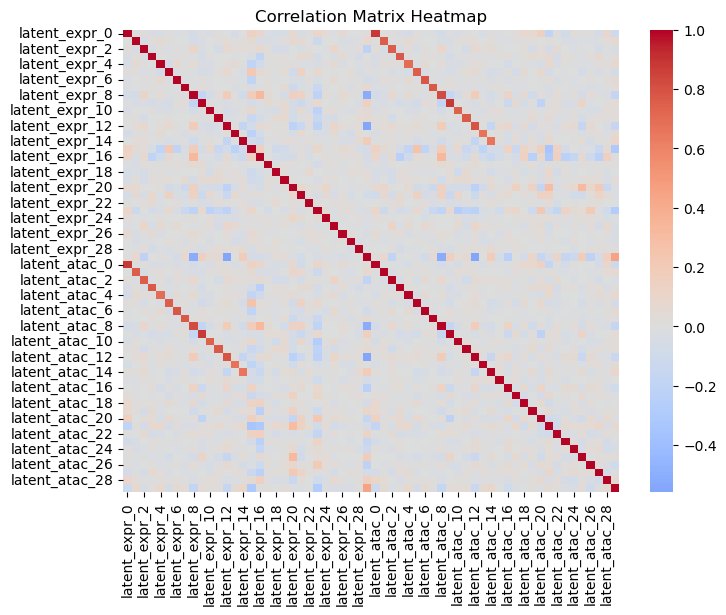

In [8]:
import pandas as pd
import seaborn as sns
df_1 = pd.DataFrame(latent_rna)
df_2 = pd.DataFrame(latent_atac)
df_combined = pd.concat([df_1, df_2],axis=1)
correlation_matrix = df_combined.corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", center=0.0)
plt.title('Correlation Matrix Heatmap')
# plt.savefig("figs/correlation_benchmark/neatseq_halo_latent_corr.png", dpi=300)
plt.show()

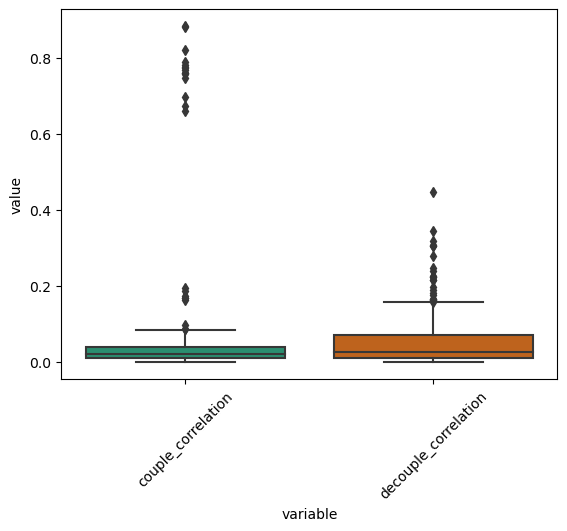

In [10]:

couple_corr = correlation_matrix.iloc[np.arange(0,15), np.arange(30,45)]
decouple_corr = correlation_matrix.iloc[np.arange(15,30), np.arange(45,60)]
df = pd.DataFrame({"variable": "couple_correlation", "value": np.abs(couple_corr.to_numpy().flatten())})
df2 = pd.DataFrame({"variable": "decouple_correlation", "value": np.abs(decouple_corr.to_numpy().flatten())})
df = pd.concat([df, df2], axis=0)
ax = sns.boxplot(x='variable', y='value', data=df, palette="Dark2")
plt.xticks(rotation=45)
plt.show()

In [11]:
df.to_csv("figs/correlation_benchmark/halo_neatseq.csv")

## HALO Training

In [16]:
HALOVI.setup_anndata(adata_mvi, batch_key="modality", time_key='GATA3-norm')
model = HALOVI(
    adata_mvi,
    n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
    n_layers = 2,
    n_latent = 30,
    n_dependent=15,
    w_a = 10
)


# HALOVI.setup_anndata(adata_mvi, batch_key="modality", time_key='GATA3-norm')
# model = HALOVI(
#     adata_mvi,
#     n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
#     n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
#     n_layers = 2,
#     n_latent = 30,
#     n_dependent=15,
#     w_a = 0
# )

self.w_a :10
yes there is aligner


## GLUE benchmark


In [ ]:
model = model.load("model_NEAT_seq_filtered_30LF_nocausal_aln",adata_mvi)


In [18]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

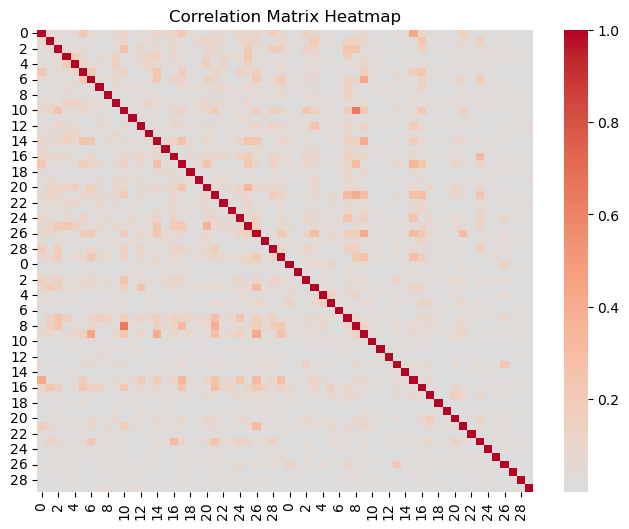

In [19]:
df_A = pd.DataFrame(latent_expr)
df_B = pd.DataFrame(latent_acc)
df_combined = pd.concat([df_A, df_B], axis=1)
correlation_matrix = np.abs(df_combined.corr())
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", center=0.0)
plt.title('Correlation Matrix Heatmap')
# plt.savefig("figs/correlation_benchmark/MB_halo_latent_corr.png", dpi=300)
plt.show()

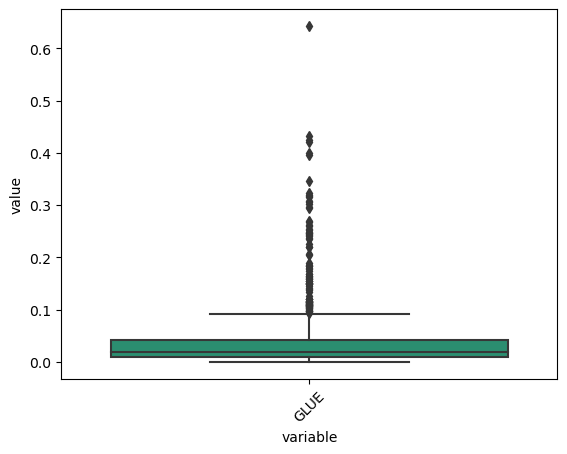

In [22]:
lower_triangular_matrix = correlation_matrix.iloc[np.arange(30), np.arange(30,60)]
lower_diagonal_values = lower_triangular_matrix.to_numpy().flatten()
df = pd.DataFrame({"variable": "GLUE", "value": lower_diagonal_values})
ax = sns.boxplot(x='variable', y='value', data=df, palette="Dark2")
df.to_csv("figs/correlation_benchmark/glue_neatseq.csv")
plt.xticks(rotation=45)
plt.show()

## multiVI benchmark


In [23]:
import scvi
scvi.model.MULTIVI.setup_anndata(adata_mvi, batch_key="modality")
vae = scvi.model.MULTIVI(adata_mvi,
    n_genes=(adata_mvi.var['modality']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['modality']=='Peaks').sum())
vae.train()

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/pytorch_lightning/trainer/configuration_validator.py:385: LightningDeprecationWarning: The `Callback.on_epoch_end` hook was deprecated in v1.6 and will be removed in v1.8. Please use `Callback.on_<train/validation/test>_epoch_end` instead.
  rank_zero_deprecation(
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/500:   0%|          | 0/500 [00:00<?, ?it/s]

/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/scvi/module/_multivae.py:557: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  /opt/conda/conda-bld/pytorch_1659484775609/work/aten/src/ATen/native/TensorShape.cpp:2985.)
  x = torch.where(mask_expr.T, x_expr.T, x_acc.T).T


Epoch 375/500:  75%|███████▍  | 374/500 [16:08<05:38,  2.68s/it, loss=7.48e+03, v_num=1]

/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/pytorch_lightning/trainer/trainer.py:726: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [24]:
vae.save("NEAT-seq_Multivi")

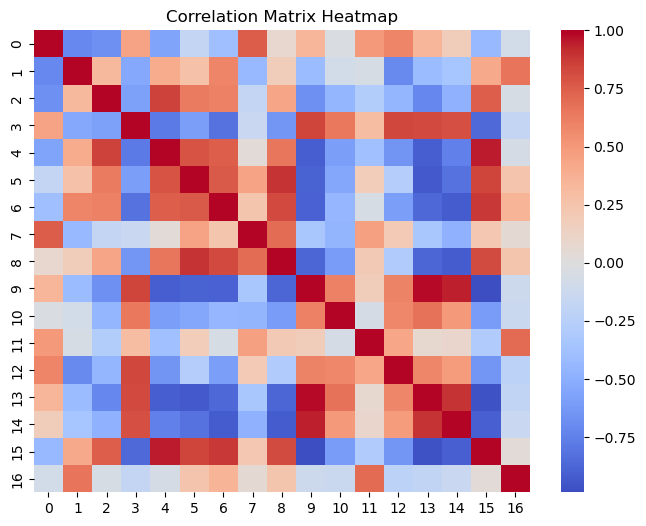

In [25]:
latent = vae.get_latent_representation()
df_combined = pd.DataFrame(latent)
correlation_matrix = df_combined.corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", center=0.0)
plt.title('Correlation Matrix Heatmap')
plt.show()

(array([0]), [Text(0, 0, 'multiVI')])

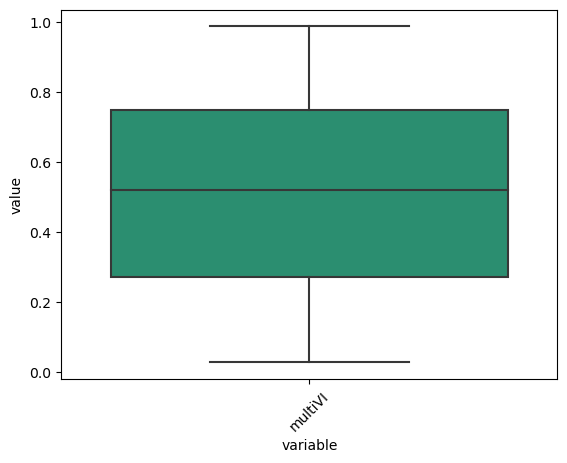

In [26]:
correlation_matrix = np.abs(correlation_matrix)
lower_triangular_matrix = np.tril(correlation_matrix, k=-1)
lower_diagonal_values = lower_triangular_matrix[lower_triangular_matrix != 0]
df = pd.DataFrame({"variable": "multiVI", "value": lower_diagonal_values})
ax = sns.boxplot(x='variable', y='value', data=df, palette="Dark2")
plt.xticks(rotation=45)

In [27]:
df.to_csv("figs/correlation_benchmark/NEATseq_corr_multiVI.csv")

In [4]:
## no aligner

HALOVI.setup_anndata(adata_mvi, batch_key="modality", time_key='GATA3-norm')
model = HALOVI(
    adata_mvi,
    n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
    n_layers = 2,
    n_latent = 30,
    n_dependent=15,
    w_a=0
)
# model = model.load2("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_2000",adata_mvi, additional={"w_a":0})
model = model.load("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_ALN_BEST",adata_mvi)

self.w_a :0
no there is no aligners
INFO     File model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_ALN_BEST/model.pt already 
         downloaded                                                                          
self.w_a :0
no there is no aligners


In [4]:
## train both RNA and ATAC
import warnings
warnings.filterwarnings("ignore")
model.module.set_finetune_params(0)
model.module.set_train_params(expr_train=True, acc_train=True)
model.train(max_epochs=1000, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1000/1000: 100%|██████████| 1000/1000 [40:12<00:00,  2.41s/it, loss=5.6e+04, v_num=1] 


In [5]:
model.save("model_NEAT_seq_filtered_30LF_nocausal_aln",overwrite=True)


In [15]:
model = model.load("model_NEAT_seq_filtered_30LF_nocausal_aln", adata_mvi)


INFO     File model_NEAT_seq_filtered_30LF_nocausal_aln/model.pt already downloaded          
n_cats_per_cov None


In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


pd1 = pd.read_csv("figs/correlation_benchmark/neatseq_glue.csv",index_col=0)
pd2 =  pd.read_csv("figs/correlation_benchmark/neatseq_halo.csv",index_col=0)
pd3 =  pd.read_csv("figs/correlation_benchmark/neatseq_mira.csv",index_col=0)
pd4 =  pd.read_csv("figs/correlation_benchmark/neatseq_multiVI.csv",index_col=0)
pd5 =  pd.read_csv("figs/correlation_benchmark/neatseq_scmvp.csv",index_col=0)
df = pd.concat([pd1, pd4, pd2, pd5, pd3], axis=0)


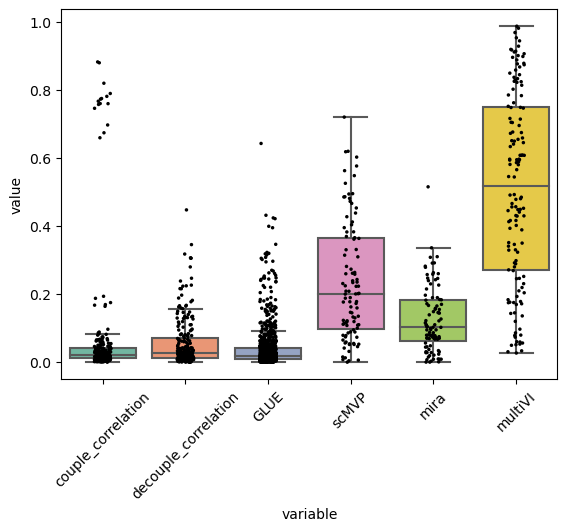

In [4]:
order = ["couple_correlation", "decouple_correlation", "GLUE", "scMVP", "mira", "multiVI"]
ax = sns.boxplot(x='variable', y='value', data=df, palette="Set2",  flierprops=dict(marker=' ', color='white', markersize=2), order=order)
sns.stripplot(x='variable', y='value', data=df, color='black', size=2.5, jitter=True, order=order)
plt.xticks(rotation=45)
ax.set_xticklabels(order)
plt.savefig("Benchmark/corr_NEATseq.pdf", dpi=300)

In [ ]:
latent_acc = adata_mvi.obs[[ 'latent_expr_0', 'latent_atac_0', 'latent_expr_1', 'latent_atac_1', 'latent_expr_2', 'latent_atac_2', 'latent_expr_3', 'latent_atac_3', 'latent_expr_4', 
'latent_atac_4', 'latent_expr_5', 'latent_atac_5', 'latent_expr_6', 'latent_atac_6', 'latent_expr_7', 'latent_atac_7', 'latent_expr_8', 'latent_atac_8', 'latent_expr_9', 'latent_atac_9', 'latent_expr_10', 'latent_atac_10', 'latent_expr_11', 'latent_atac_11', 'latent_expr_12', 'latent_atac_12', 'latent_expr_13', 'latent_atac_13', 'latent_expr_14', 'latent_atac_14', 'latent_expr_15', 'latent_atac_15', 'latent_expr_16', 'latent_atac_16', 'latent_expr_17', 'latent_atac_17', 'latent_expr_18', 'latent_atac_18', 'latent_expr_19', 'latent_atac_19', 'latent_expr_20', 'latent_atac_20', 
'latent_expr_21', 'latent_atac_21', 'latent_expr_22', 'latent_atac_22', 'latent_expr_23', 'latent_atac_23', 'latent_expr_24', 'latent_atac_24', 'latent_expr_25', 'latent_atac_25', 
'latent_expr_26', 'latent_atac_26', 'latent_expr_27', 'latent_atac_27', 'latent_expr_28', 'latent_atac_28', 'latent_expr_29', 'latent_atac_29']]

In [6]:
rna_data_norm = model.get_normalized_expression()
atac_data_est = model.get_accessibility_estimates()

In [9]:
rna_data_norm = model.get_normalized_expression(rna_data)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup       


ValueError: Number of vars in adata_target not the same as source. Expected: 13380 Received: 91583

In [ ]:
rna_data_norm = model.get_normalized_expression()


In [13]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

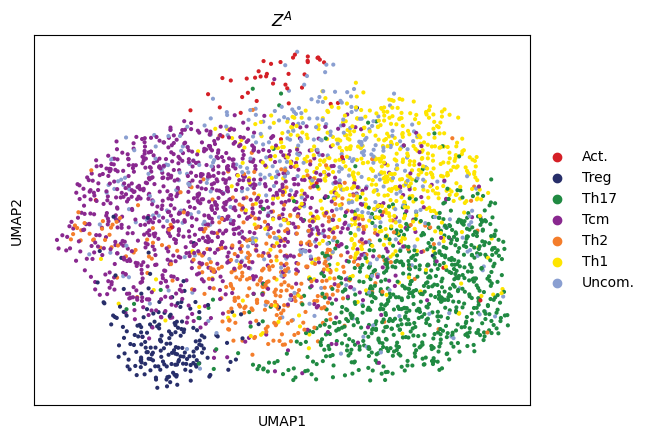

In [22]:
adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

# %matplotlib inline
# sc.pl.umap(adatssa_mvi,color='GATA3-norm',title = '$Z^{A}$',
#        vmin = 'p2', vmax= 'p98')
# plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()

# %matplotlib inline
# sc.pl.umap(adata_mvi,color=['ReadsInPeaks'])
# plt.show()
adata_mvi.obsm["umap_atac"] = adata_mvi.obsm["X_umap"]

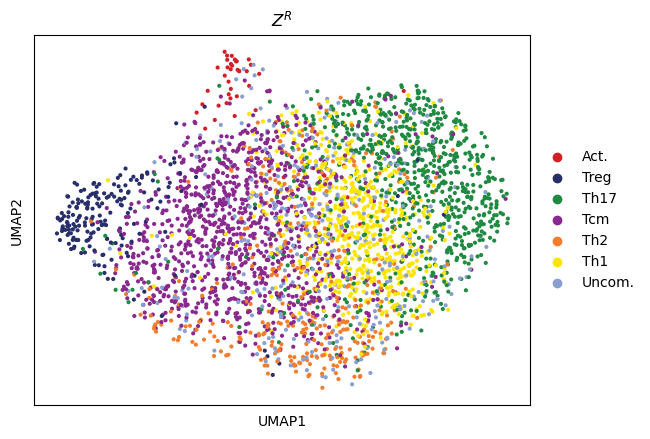

In [21]:
adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

# %matplotlib inline
# sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
#        vmin = 'p2', vmax= 'p98')
# plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()
adata_mvi.obsm["umap_rna"] = adata_mvi.obsm["X_umap"]

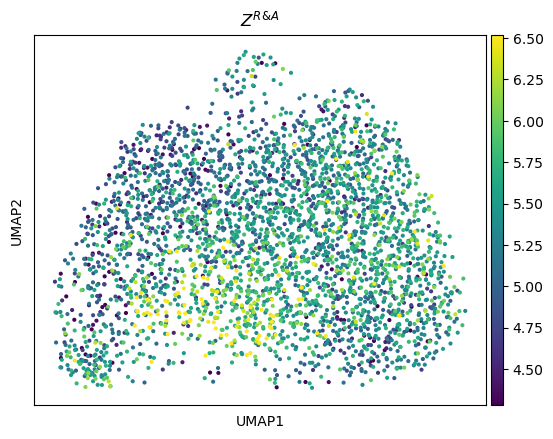

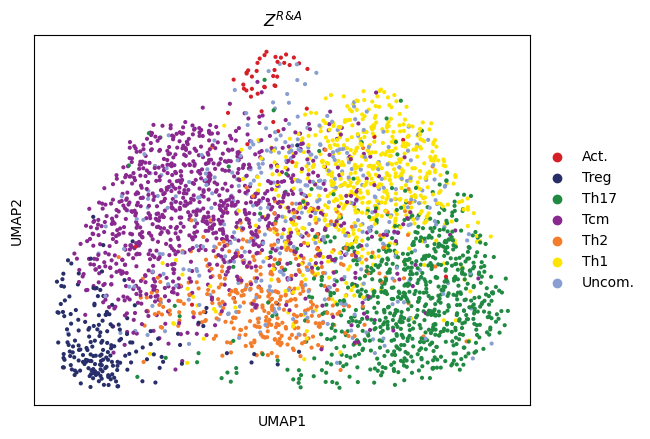

In [16]:
adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R & A}$',
                palette=Cluster_color
             )
plt.show()

In [18]:
adata_mvi

AnnData object with n_obs × n_vars = 3370 × 91583
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters', 'GATA3_norm2', '_scvi_batch', '_scvi_labels', 'latent_expr_0', 'latent_atac_0', 'latent_expr_1', 'latent_atac_1', 'latent_expr_2', 'latent_atac_2', 'latent_expr_3', 'latent_atac_3', 'latent_expr_4', 'latent_atac_4', 'latent_expr_5', 'latent_atac_5', 'latent_expr_6', 'latent_atac_6', 'latent_expr_7', 'latent_atac_7', 'latent_expr_8', 'latent_atac_8', 'latent_

In [20]:
adata_mvi.obsm["umap_both"] = adata_mvi.obsm["X_umap"]

In [61]:
from complementary_models import split_rna
rna_data = split_rna(adata_mvi=adata_mvi)

In [79]:
rna_data_norm = model.get_normalized_expression()
rna_data_norm = rna_data_norm*1e25
rna_data_norm

,AL627309.5,LINC01409,LINC01128,LINC00115,NOC2L,KLHL17,ISG15,C1orf159,TNFRSF18,TNFRSF4,...,MT-CO3,MT-ND3,MT-ND4L,MT-ND4,MT-ND5,MT-ND6,MT-CYB,AL354822.1,AL592183.1,AC240274.1
lane1#AAACCAACATAGCGAG-1_paired,7.647887e+04,1.685130e+00,2.942727e-19,1.422850e-15,3.880013e-08,2.310752e-02,1.666342e-02,1.173241e-10,0.000000e+00,4.101685e-04,...,3.931080e+05,7.591386e+12,9.608243e-10,1.784346e+00,1.923108e-06,8.818366e-10,4.944093e-01,1.391656e-06,1.202594e-16,3.112413e-01
lane1#AAACCAACATTCAGCA-1_paired,1.156489e-04,2.412317e-11,0.000000e+00,7.498348e-17,5.161753e-04,1.979130e-06,0.000000e+00,6.277817e-18,0.000000e+00,6.331286e-12,...,1.618636e+01,2.000498e+18,3.251012e-18,8.016188e-09,1.702463e-13,7.006492e-20,3.879482e-09,0.000000e+00,0.000000e+00,2.075731e+00
lane1#AAACCGAAGGCTGTCA-1_paired,1.274794e+02,1.521649e+03,2.802597e-20,4.806716e+04,7.321373e-04,2.742168e-06,3.750217e-13,3.496588e-05,2.280534e-02,1.113987e-08,...,1.754068e+02,1.253319e+12,8.091966e-06,3.081022e+02,3.436932e+02,2.789447e+03,4.539943e-06,5.883775e-08,5.260994e-10,2.032767e+09
lane1#AAACCGGCAAGGGTTG-1_paired,7.018503e-04,4.533463e+06,2.941021e-12,4.015225e+03,2.845429e-05,5.777142e-11,4.379490e-02,6.121062e-12,1.171425e-04,1.470972e+02,...,1.206073e-03,1.735364e+00,5.238360e-04,3.571013e-03,4.213579e-09,1.363656e-09,5.651661e-08,1.085259e+08,1.424725e+01,1.068504e+02
lane1#AAACGGATCCTGTTCA-1_paired,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.441062e-17,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,8.425868e-16,2.583301e+01,0.000000e+00,1.121039e-19,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lane2#TTTGTGAAGTTGGATC-1_paired,1.364578e+03,4.873839e-05,0.000000e+00,0.000000e+00,8.816316e-08,1.261169e-19,0.000000e+00,7.062728e+04,6.043520e-15,1.260607e-07,...,2.350050e-03,3.558203e+07,1.821688e-19,3.962494e-05,1.632118e+00,0.000000e+00,3.471016e-16,1.359260e-18,2.802597e-20,1.356457e-17
lane2#TTTGTGGCAATAACGA-1_paired,2.265978e+02,1.387285e-18,0.000000e+00,0.000000e+00,4.995848e-11,9.168411e-07,0.000000e+00,5.899467e-18,0.000000e+00,3.093927e-16,...,6.259595e-06,1.832425e+06,0.000000e+00,9.727003e-02,2.648489e+02,0.000000e+00,4.266929e-14,8.407791e-20,0.000000e+00,5.184804e-19
lane2#TTTGTGGCACCCTCAC-1_paired,3.146756e-16,5.756802e-04,7.006492e-20,5.264330e-12,1.607951e-04,2.142734e-10,0.000000e+00,2.342074e-04,1.229013e-12,9.177192e-04,...,1.182040e-03,4.182387e+11,0.000000e+00,1.415597e-01,7.067401e+00,2.972830e-08,1.801199e-10,0.000000e+00,2.078190e-08,2.113216e-05
lane2#TTTGTGTTCAGGTCCA-1_paired,1.166801e+03,1.177091e-18,0.000000e+00,0.000000e+00,7.149119e-01,2.092268e-08,5.826599e-17,5.098150e+00,0.000000e+00,4.456129e-18,...,5.150993e+01,1.270533e+10,1.349310e-15,3.668564e+02,7.917706e+00,7.593037e-07,7.851340e-04,8.782666e-15,0.000000e+00,3.921893e-02


In [74]:
rna_data.X[:, 0].data

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 2., 1., 1., 1., 1., 1., 1.,
       1., 1., 4., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1.], dtype=float32)

In [80]:
rna_data.layers["norm"] = rna_data_norm

In [81]:
rna_data.write_h5ad("data/datasets/NEAT_Seq/rna_norm.h5ad")

In [14]:
adata_mvi

AnnData object with n_obs × n_vars = 3370 × 91583
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters', 'GATA3_norm2', '_scvi_batch', '_scvi_labels', 'latent_expr_0', 'latent_atac_0', 'latent_expr_1', 'latent_atac_1', 'latent_expr_2', 'latent_atac_2', 'latent_expr_3', 'latent_atac_3', 'latent_expr_4', 'latent_atac_4', 'latent_expr_5', 'latent_atac_5', 'latent_expr_6', 'latent_atac_6', 'latent_expr_7', 'latent_atac_7', 'latent_expr_8', 'latent_atac_8', 'latent_

In [58]:
atac_norm = model.get_accessibility_estimates(library_size=1e5)
atac_norm.shape


(3370, 78203)

In [59]:
atac_norm

,chr1-817095-817595,chr1-827298-827798,chr1-844407-844907,chr1-857908-858408,chr1-869618-870118,chr1-898676-899176,chr1-904489-904989,chr1-920983-921483,chr1-923614-924114,chr1-940165-940665,...,chrX-155216123-155216623,chrX-155216655-155217155,chrX-155262900-155263400,chrX-155263764-155264264,chrX-155264292-155264792,chrX-155279869-155280369,chrX-155612706-155613206,chrX-155632526-155633026,chrX-155767205-155767705,chrX-155881023-155881523
lane1#AAACCAACATAGCGAG-1_paired,1.063079,0.649187,0.182364,0.152024,1.232517,0.032723,0.289975,0.062297,0.432977,0.248576,...,4.064725,0.577868,0.231173,0.217024,2.084213,0.370253,0.159493,0.669471,0.108813,3.139069
lane1#AAACCAACATTCAGCA-1_paired,0.296657,2.131181,0.342796,0.107029,0.906661,0.327894,0.458133,0.061107,0.914066,0.758605,...,5.422416,1.196754,0.632488,0.684210,2.663144,0.043922,0.275006,0.741699,0.050304,2.635250
lane1#AAACCGAAGGCTGTCA-1_paired,0.319617,0.784583,0.294161,0.449172,1.032565,0.062809,0.786313,0.264196,0.323431,0.377392,...,3.193997,0.527544,0.482136,0.400246,2.140226,0.398316,0.442377,1.200883,0.086097,3.879281
lane1#AAACCGGCAAGGGTTG-1_paired,0.127903,1.448082,0.166792,0.123627,0.697067,0.115139,0.431006,0.376706,0.069489,0.233425,...,2.926037,0.477172,0.602201,0.430915,2.330670,0.066041,1.087627,0.911746,0.326719,3.691527
lane1#AAACGGATCCTGTTCA-1_paired,0.769182,1.215676,0.443255,0.121248,0.858572,0.057693,1.071215,0.454883,0.450732,0.247592,...,3.295537,0.542760,0.285191,0.251032,1.964470,0.238034,0.320841,0.899548,0.232016,2.551565
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lane2#TTTGTGAAGTTGGATC-1_paired,0.047592,1.298739,0.589620,0.111321,0.788047,0.008369,0.792850,0.111227,0.107043,0.211117,...,3.565943,0.267188,0.603306,0.192191,2.604336,0.106567,1.326190,0.357644,0.037097,2.711176
lane2#TTTGTGGCAATAACGA-1_paired,0.087545,1.303462,0.032568,0.101053,1.280811,0.054675,0.166073,0.094809,0.131905,0.278090,...,3.595163,0.599434,0.411642,1.315817,2.063847,0.023605,1.601442,1.123786,0.084950,3.050301
lane2#TTTGTGGCACCCTCAC-1_paired,0.053955,1.166934,0.049249,0.350238,1.515749,0.039550,0.190724,0.008691,0.174968,0.325612,...,3.370257,0.878075,0.315391,0.143562,2.289124,0.033874,0.190665,1.171392,0.001169,3.784318
lane2#TTTGTGTTCAGGTCCA-1_paired,0.022426,0.598602,0.225431,0.021069,1.341526,0.021979,0.800090,0.060104,0.349399,0.068403,...,2.538747,0.851593,1.327202,0.235228,2.454880,0.076237,0.333979,0.645539,0.026980,2.798388


In [23]:
# from complementary_models import split_atac

# atac_data = split_atac(adata_mvi=adata_mvi)
atac_data.layers["norm"] = atac_norm

In [60]:
atac_data.write_h5ad("data/datasets/NEAT_Seq/atac_norm.h5ad")

In [27]:
atac_data.var

,gene_ids,feature_types,n_cells,modality
chr1-817095-817595,chr1-817095-817595,Peaks,45,Peaks
chr1-827298-827798,chr1-827298-827798,Peaks,153,Peaks
chr1-844407-844907,chr1-844407-844907,Peaks,45,Peaks
chr1-857908-858408,chr1-857908-858408,Peaks,16,Peaks
chr1-869618-870118,chr1-869618-870118,Peaks,133,Peaks
...,...,...,...,...
chrX-155279869-155280369,chrX-155279869-155280369,Peaks,18,Peaks
chrX-155612706-155613206,chrX-155612706-155613206,Peaks,48,Peaks
chrX-155632526-155633026,chrX-155632526-155633026,Peaks,70,Peaks
chrX-155767205-155767705,chrX-155767205-155767705,Peaks,19,Peaks


In [44]:
def get_top_peaks(loadingmatrix, i, adata, top=100):
        toppeaks = np.argsort(loadingmatrix[:, i])[-top:]
        toppeaks = toppeaks[::-1]
        peaks = adata.var.index[toppeaks].to_numpy().astype(str)
        return peaks


In [30]:
loadingmatrix = model.get_atac_loading()
loadingmatrix = loadingmatrix.T


In [43]:
get_top_peaks(loadingmatrix, 10, atac_data, top=200).to_numpy().astype(str)


array(['chr1-959051-959551', 'chr1-1014255-1014755', 'chr1-984060-984560',
       'chr1-965958-966458', 'chr1-1058766-1059266', 'chr1-869618-870118',
       'chr1-1019221-1019721', 'chr1-1000638-1001138',
       'chr1-940165-940665', 'chr1-827298-827798', 'chr1-1019820-1020320',
       'chr1-904489-904989', 'chr1-920983-921483', 'chr1-1001773-1002273',
       'chr1-966747-967247', 'chr1-999956-1000456',
       'chr1-1013248-1013748', 'chr1-1064068-1064568',
       'chr1-1059416-1059916', 'chr1-999135-999635',
       'chr1-1040596-1041096', 'chr1-898676-899176', 'chr1-817095-817595',
       'chr1-1032976-1033476', 'chr1-857908-858408', 'chr1-975942-976442',
       'chr1-923614-924114', 'chr1-960320-960820', 'chr1-1020639-1021139',
       'chr1-844407-844907'], dtype='<U20')

In [48]:
for i in range(30):
    path = "data/datasets/NEAT_Seq/outputs/"
    file = "latent_{}_peaks.csv".format(i)
    peaks = get_top_peaks(loadingmatrix, i, atac_data, top=200)
    np.savetxt(path+file, peaks, fmt="%s")

0


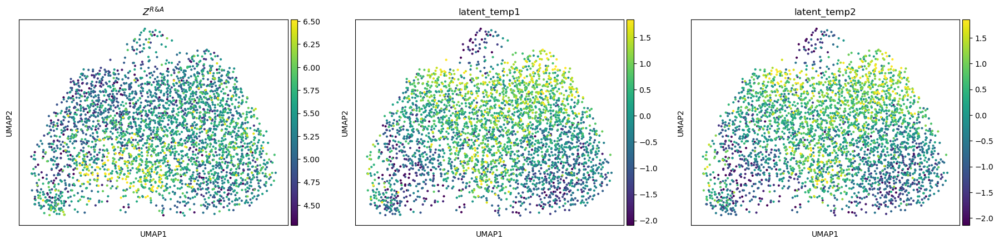

1


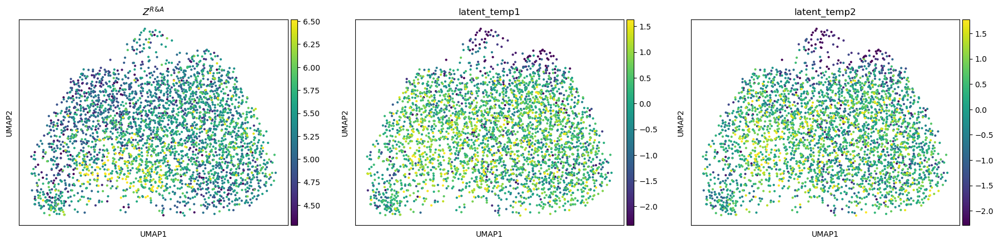

2


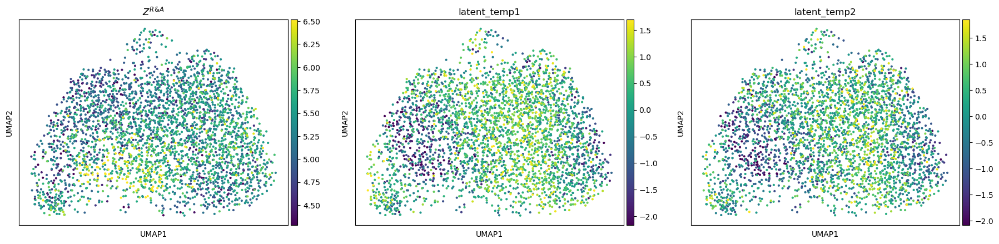

3


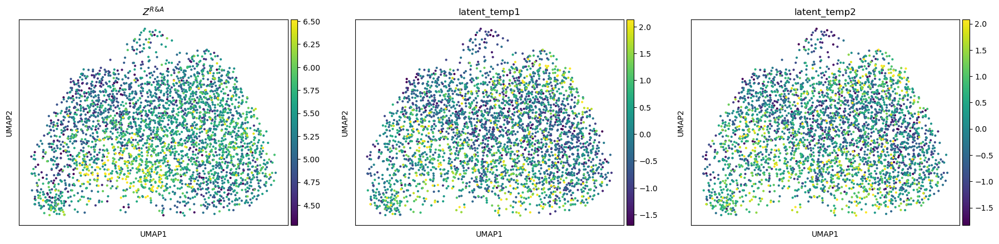

4


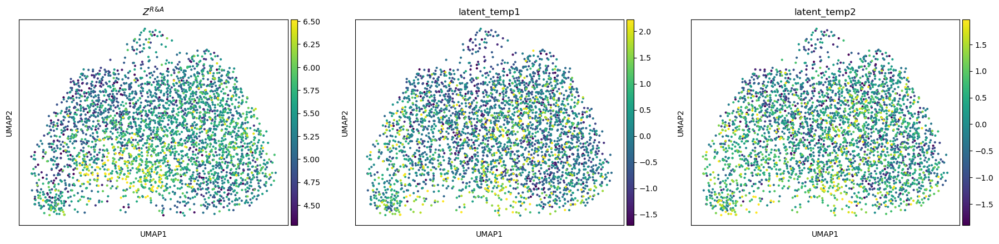

5


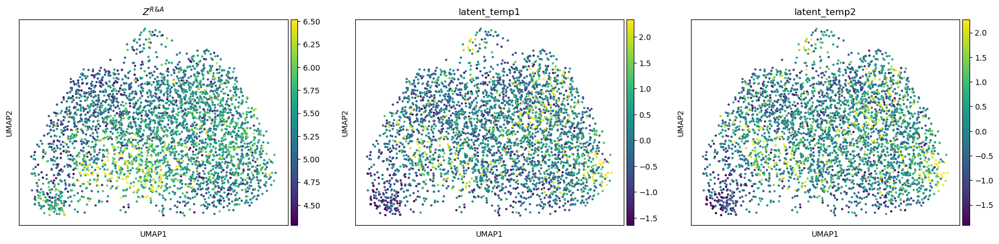

6


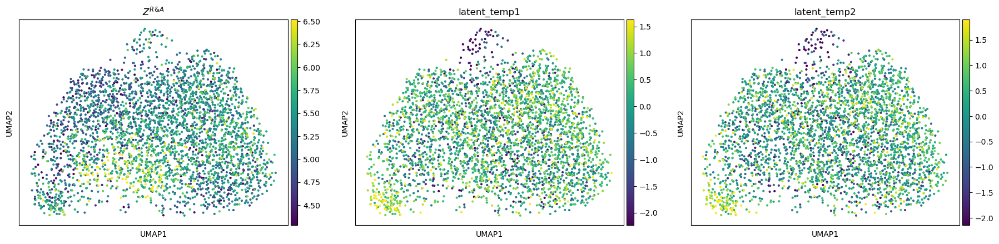

7


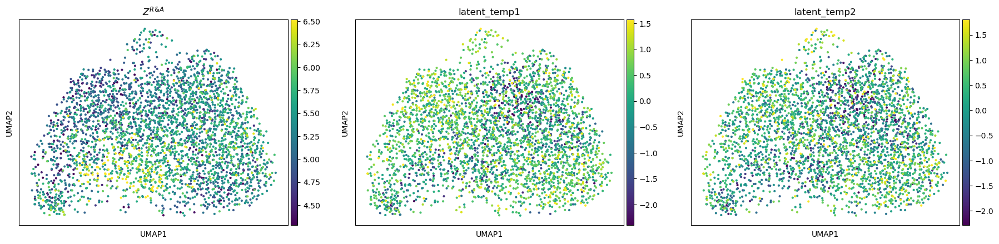

8


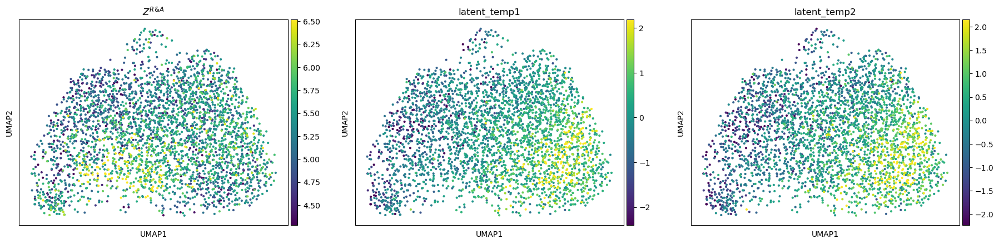

9


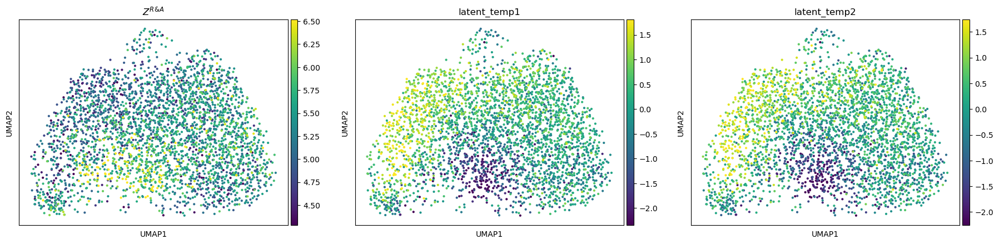

10


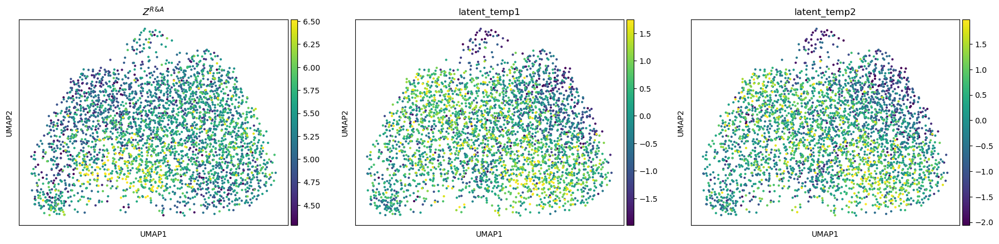

11


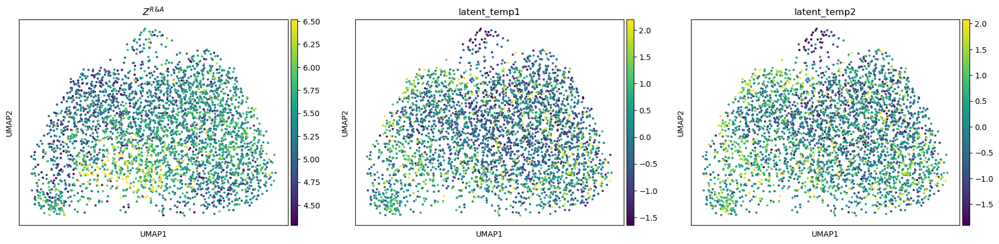

12


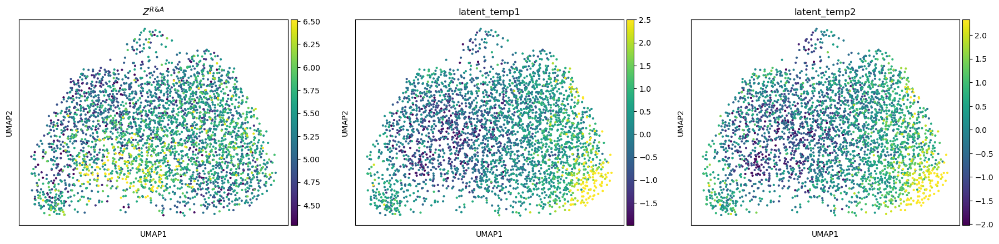

13


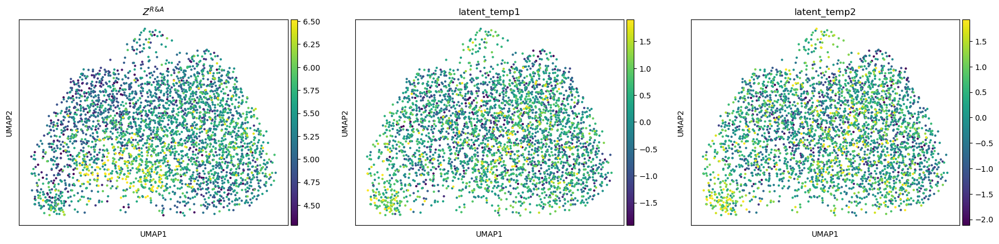

14


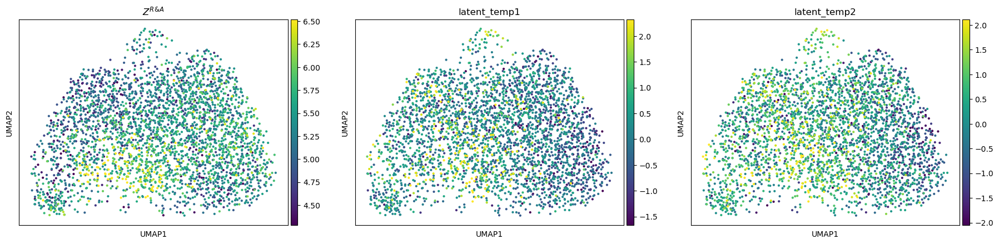

In [11]:
for i in range(15):
    print(i)
    adata_mvi.obs["latent_temp1"] = latent_acc[:, i]
    adata_mvi.obs["latent_temp2"] = latent_expr[:, i]
   
    sc.pl.umap(adata_mvi,color=['GATA3-norm',"latent_temp1", "latent_temp2"],title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98')
    plt.show()

    %matplotlib inline
    # sc.pl.umap(adata_mvi,color= "latent_temp1",title = '$Z^{R & A}$',
    #                 palette=Cluster_color
    #             )

    # sc.pl.umap(adata_mvi,color= "latent_temp2",title = '$Z^{R & A}$',
    #                 palette=Cluster_color
    #             )            
    # plt.show()

In [17]:
for i in range(30):
    latent_name_1 = "latent_expr_{}".format(i)
    latent_name_2 = "latent_atac_{}".format(i)
    adata_mvi.obs[latent_name_1] = latent_acc[:, i]
    adata_mvi.obs[latent_name_2] = latent_expr[:, i]

    

In [23]:
adata_mvi.write_h5ad("data/datasets/NEAT_Seq/neat_multiome.h5ad")

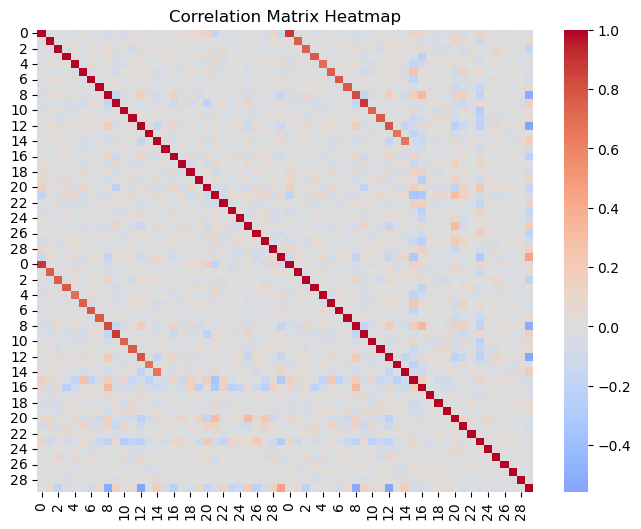

In [12]:
import seaborn as sns
df_A = pd.DataFrame(latent_expr)
df_B = pd.DataFrame(latent_acc)
df_combined = pd.concat([df_A, df_B], axis=1)
correlation_matrix = df_combined.corr()
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f", center=0.0)
plt.title('Correlation Matrix Heatmap')
# plt.savefig("figs/Hair/20_aligned/mouse_latent_corr.png", dpi=300)
plt.show()

In [ ]:
topgenes_latent = model.get_top_genes(200, loadingmatrix=rnaloading, latent_index=i, \
    rnadata =rna_data,colname="index")

In [30]:
model.train(max_epochs=500, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|██████████| 500/500 [19:41<00:00,  2.36s/it, loss=5.69e+04, v_num=1]


In [6]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

UnboundLocalError: local variable 'pred_expr_dep_m' referenced before assignment

In [32]:
model.save("model_NEAT_seq_filtered_30LF_nocausal_epoch1500",overwrite=True)

In [33]:
model.train(max_epochs=500, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|██████████| 500/500 [19:44<00:00,  2.37s/it, loss=5.68e+04, v_num=1]


In [34]:
model.save("model_NEAT_seq_filtered_30LF_nocausal_epoch2000",overwrite=True)

In [5]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

UnboundLocalError: local variable 'pred_expr_dep_m' referenced before assignment

## Causal Constrain

In [4]:
## no alingner 
model = model.load2("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_2000",adata_mvi, additional={"w_2":0})

INFO     File model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_2000/model.pt already     
         downloaded                                                                          


AttributeError: 'NoneType' object has no attribute 'keys'

In [22]:
# model = model.load("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_1500_ALN",adata_mvi)
model = model.load("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_3500_ALGN",adata_mvi)
# model = model.load("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_4000_ALN_w10",adata_mvi)

INFO     File model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_3500_ALGN/model.pt already
         downloaded                                                                          
n_cats_per_cov None


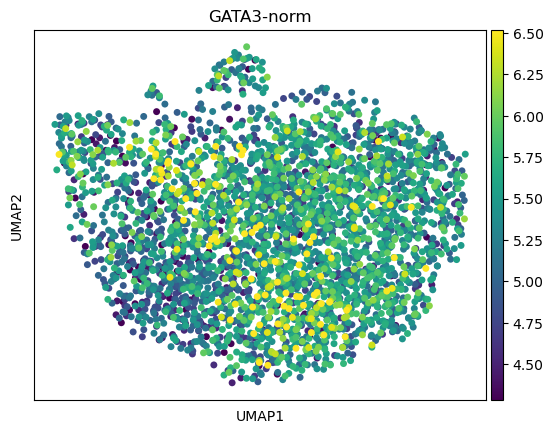

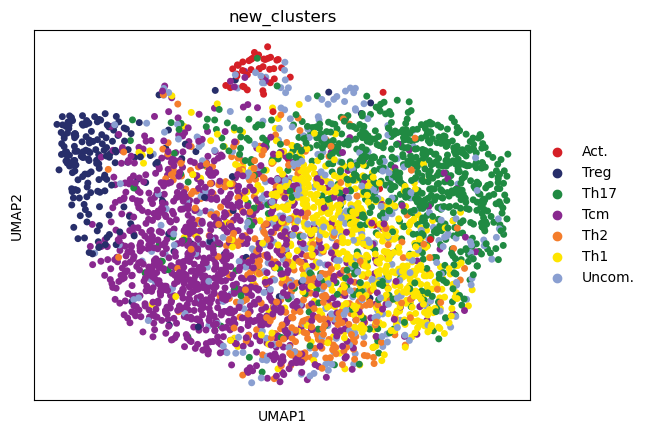

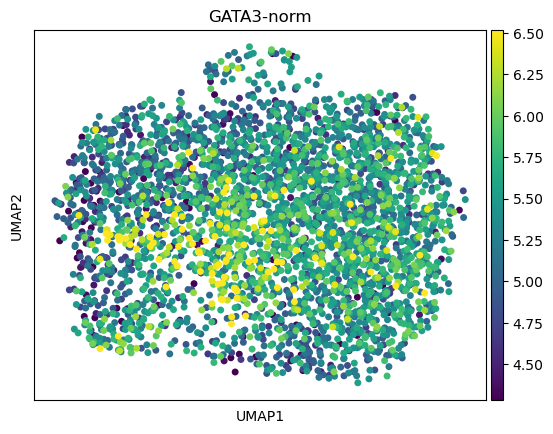

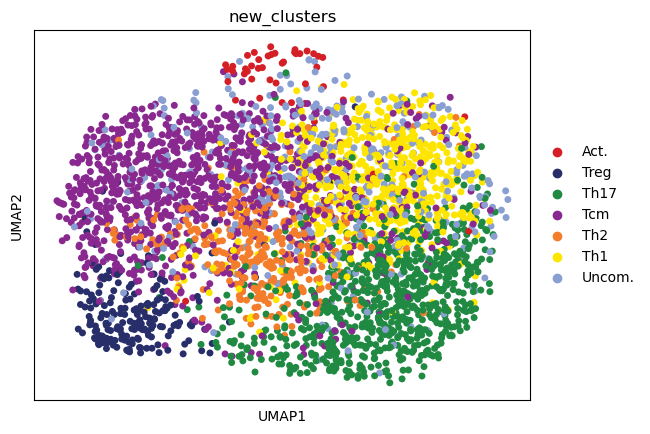

In [43]:
# latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm', vmin = 'p2', vmax= 'p98', size=100)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',palette=Cluster_color, size=100)
plt.show()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm', vmin = 'p2', vmax= 'p98',size=100)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',palette=Cluster_color, size=100)
plt.show()

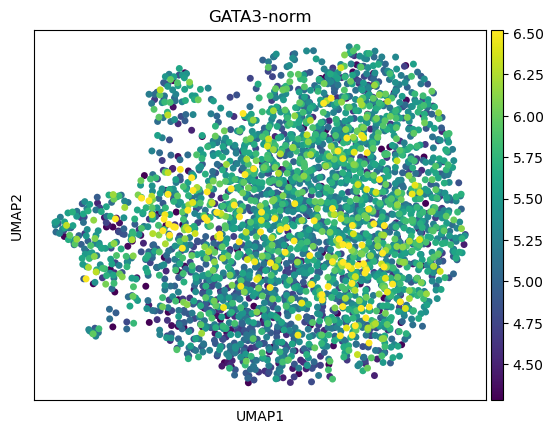

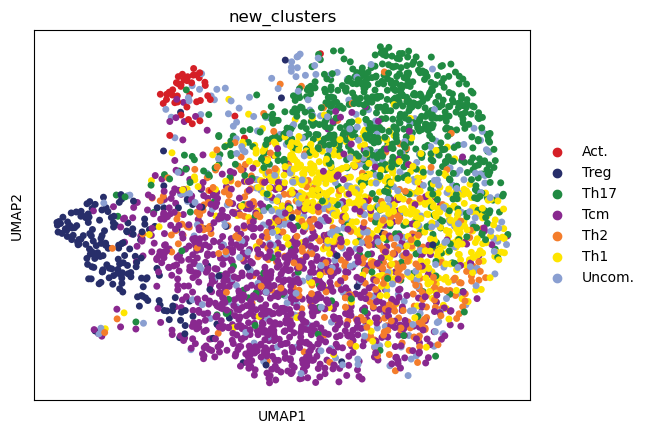

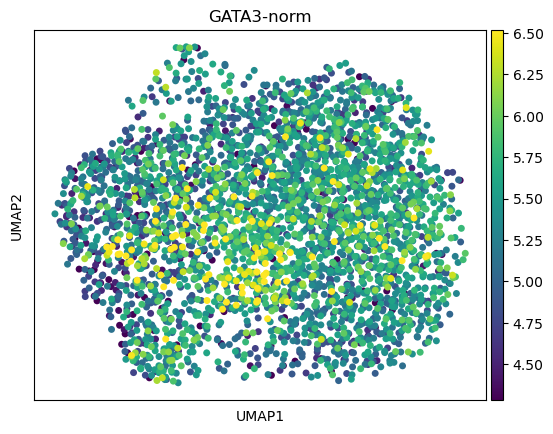

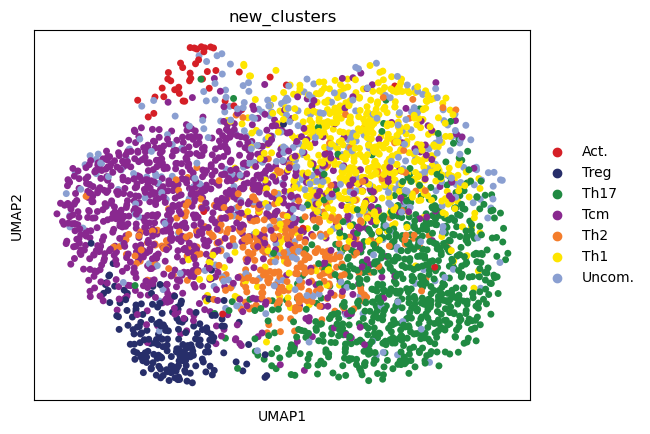

In [22]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm', vmin = 'p2', vmax= 'p98', size=100)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',palette=Cluster_color, size=100)
plt.show()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm', vmin = 'p2', vmax= 'p98',size=100)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',palette=Cluster_color, size=100)
plt.show()

In [18]:
model.module.alpha = 0.05
model.module.beta_2 = 1e7
model.module.beta_3 = 2e8
model.module.beta_1 = 1e7
model.w_a = 0
print(model.module.alpha)

0.05


In [21]:
## finetune without L0
model.module.set_finetune_params(2)
model.module.set_train_params(expr_train=True, acc_train=True)
model.plan_kwargs = {"n_epochs_kl_warmup":50}
model.train(max_epochs=500, batch_size=512)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/pytorch_lightning/trainer/trainer.py:1933: PossibleUserWarning: The number of training batches (6) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 251/500:  50%|█████     | 250/500 [11:09<11:09,  2.68s/it, loss=1.31e+05, v_num=1]

/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/pytorch_lightning/trainer/trainer.py:726: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [44]:
model.save("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_ALN_BEST2",overwrite=True)

In [37]:
model = model.load("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_2000_ALN",adata_mvi)

INFO     File model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_2000_ALN/model.pt already 
         downloaded                                                                          
n_cats_per_cov None


In [43]:
model.save("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_3500_ALGN",overwrite=True)

# model = model.load("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_3500_ALGN",adata_mvi)

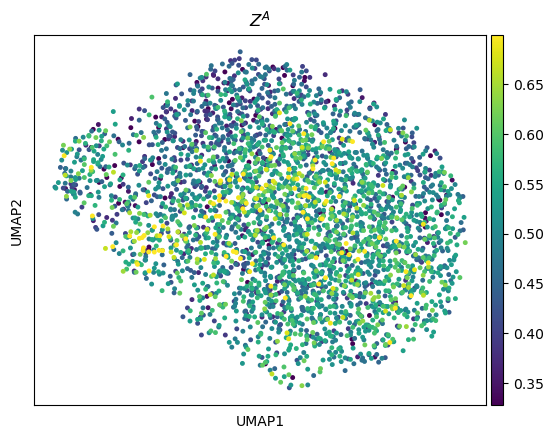

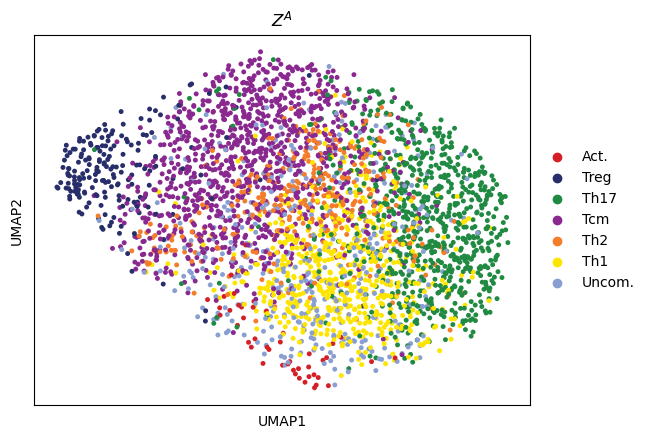

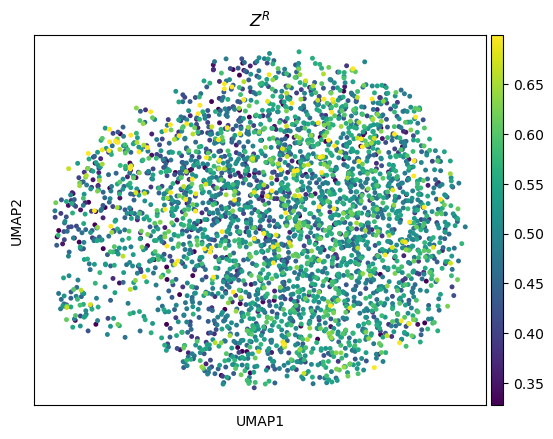

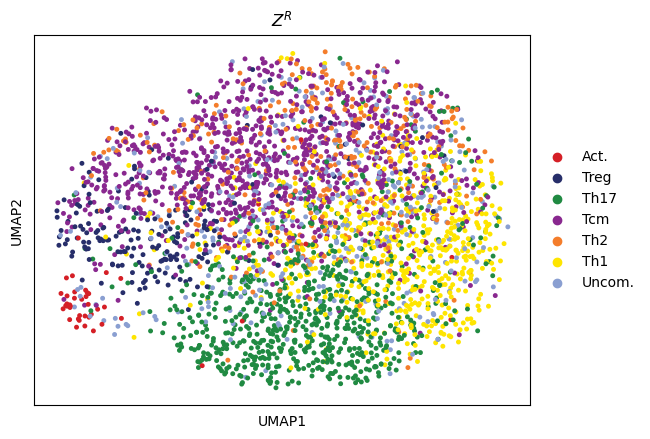

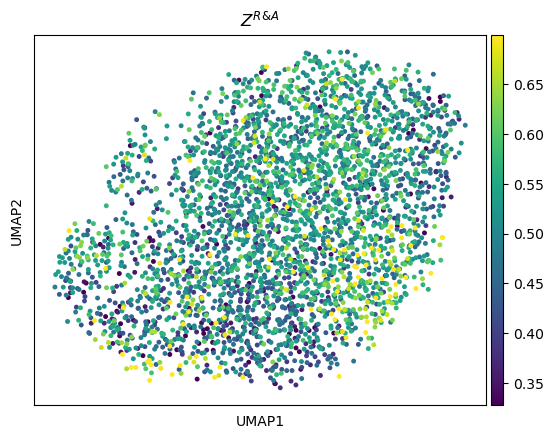

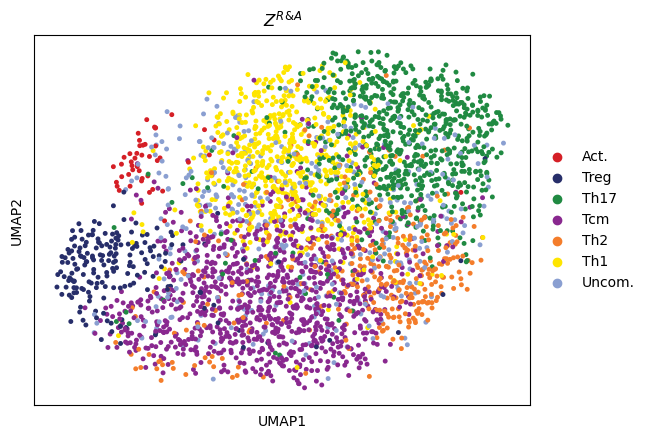

In [14]:
# latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{A}$',
       vmin = 'p2', vmax= 'p98',size=50)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color,size=50
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
       vmin = 'p2', vmax= 'p98',size=50)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color, size=50
             )
plt.show()

adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98',size=50)
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R & A}$',
                palette=Cluster_color,size=50
             )
plt.show()

In [34]:
model.train(max_epochs=100, batch_size=512)

/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/scvi/model/base/_training_mixin.py:67: UserWarning: max_epochs=100 is less than n_epochs_kl_warmup=400. The max_kl_weight will not be reached during training.
  warnings.warn(
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/pytorch_lightning/trainer/trainer.py:1933: PossibleUserWarning: The number of training batches (6) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 100/100: 100%|██████████| 100/100 [02:51<00:00,  1.72s/it, loss=3.52e+03, v_num=1]


In [27]:
model.save("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1500_ALN",overwrite=True)

In [49]:
model.save("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_2000",overwrite=True)

## load pretrain model

In [9]:
model = model.load("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000",adata_mvi)

INFO     File model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000/model.pt already     
         downloaded                                                                          
n_genes :13380
n_peaks:78203
fine tune is False
gate decoder initialization n_input 30, n_output 78203,         n_hidden_local 20, n_hidden_global 128, n_cat_list [1], *cat_list 1


In [12]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

In [11]:
sc.settings.vector_friendly = False

In [58]:
from complementary_models import torch_infer_nonsta_dir

latent_atac_indep_t = torch.tensor(latent_atac_indep).to('cuda')
latent_expr_indep_t = torch.tensor(latent_expr_indep).to('cuda')
times = torch.tensor(times).to('cuda')

score3, _, _ = torch_infer_nonsta_dir(latent_atac_indep_t, latent_expr_indep_t, times)
score4, _, _ = torch_infer_nonsta_dir(latent_expr_indep_t, latent_atac_indep_t, times)
print("score3 {} and score4 {}".format(score3, score4))
score3 - score4

score3 0.04758064432024327 and score4 0.04758067441082519


tensor(-3.0091e-08, device='cuda:0', dtype=torch.float64)

In [59]:
latent_atac_dep_t = torch.tensor(latent_atac_dep).to('cuda')
latent_expr_dep_t = torch.tensor(latent_expr_dep).to('cuda')
times = torch.tensor(times).to('cuda')

score3, _, _ = torch_infer_nonsta_dir(latent_atac_dep_t, latent_expr_dep_t, times)
score4, _, _ = torch_infer_nonsta_dir(latent_expr_dep_t, latent_atac_dep_t, times)
print("score3 {} and score4 {}".format(score3, score4))
score3 - score4

score3 0.047580630624712614 and score4 0.04758073252769567


tensor(-1.0190e-07, device='cuda:0', dtype=torch.float64)

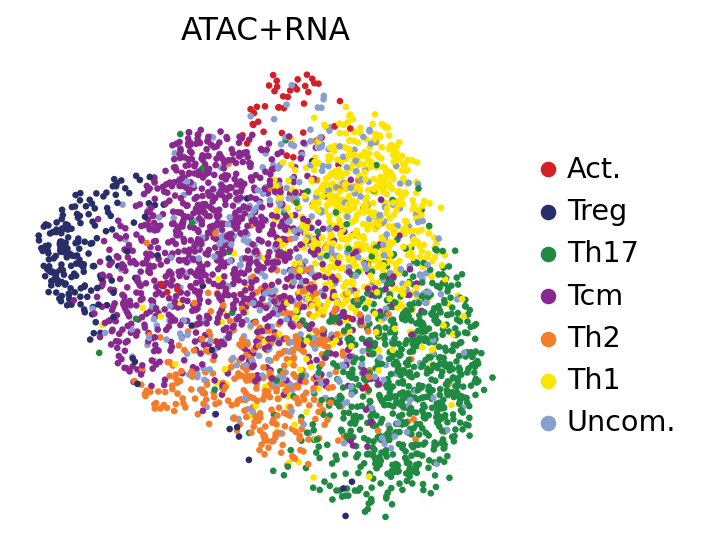

<Figure size 320x320 with 0 Axes>

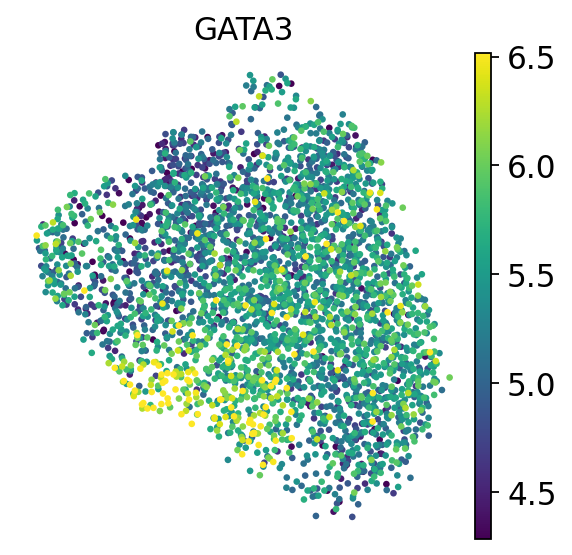

<Figure size 320x320 with 0 Axes>

In [72]:
path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
figure_name = "_atac+RNA"
format = ".pdf"
save_path = figure_name+format
sc.set_figure_params(vector_friendly=True)

adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

sc.pl.umap(adata_mvi,color='new_clusters',title = 'ATAC+RNA',
                palette=Cluster_color,frameon = False,
                save=save_path
             )
plt.savefig(save_path, bbox_inches="tight",dpi=300)


figure_name = "_ATAC+RNA_GATA3-norm"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi,color='GATA3-norm',title = 'GATA3',
       vmin = 'p2', vmax= 'p98',frameon = False,
       save=save_path)
plt.savefig(save_path, bbox_inches="tight", dpi=300)  


<Figure size 320x320 with 0 Axes>

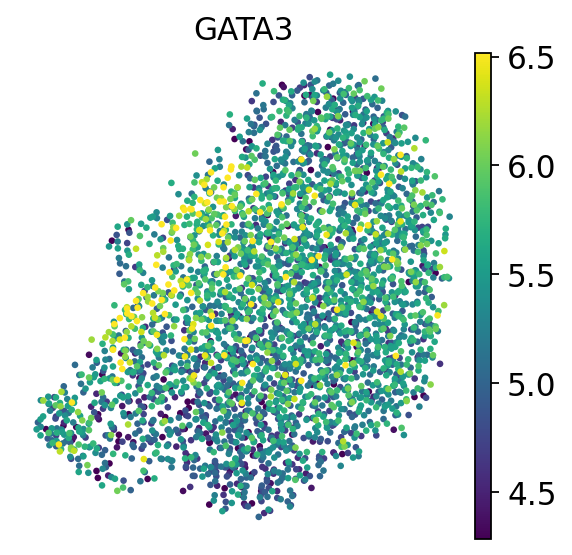

<Figure size 320x320 with 0 Axes>

In [65]:

path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
figure_name = "_RNA"
format = ".pdf"
save_path = figure_name+format
sc.set_figure_params(vector_friendly=True)

adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

sc.pl.umap(adata_mvi,color='new_clusters',title = 'RNA',
                palette=Cluster_color,frameon = False,
                save=save_path
             )
plt.savefig(save_path, bbox_inches="tight",dpi=300)


figure_name = "_RNA_GATA3-norm"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi,color='GATA3-norm',title = 'GATA3',
       vmin = 'p2', vmax= 'p98',frameon = False,
       save=save_path)
plt.savefig(save_path, bbox_inches="tight", dpi=300)  

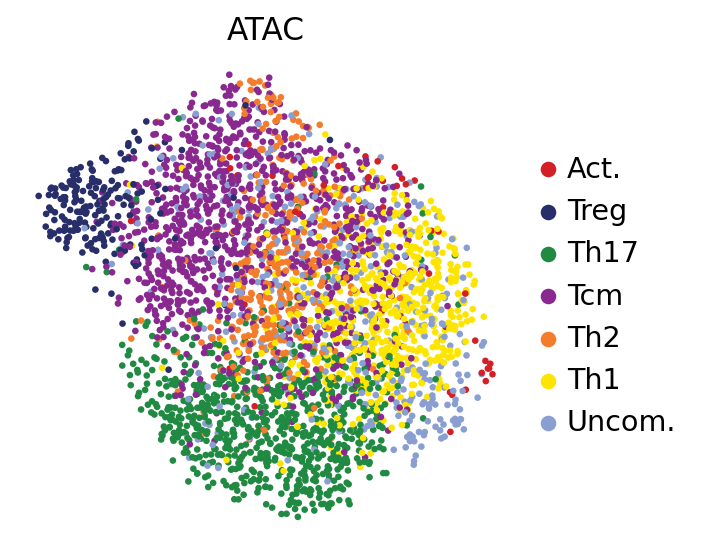

<Figure size 320x320 with 0 Axes>

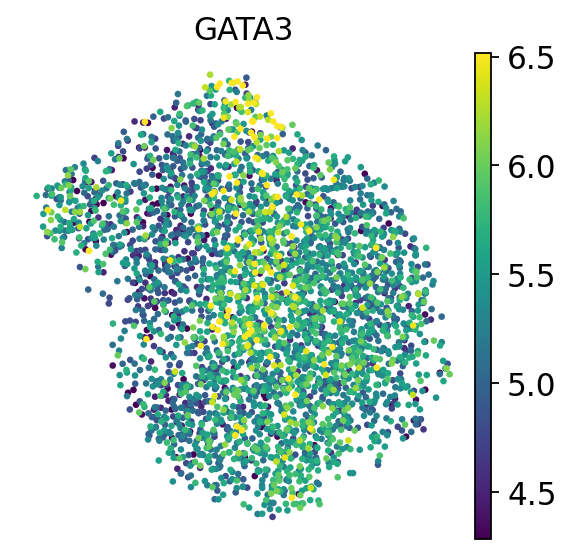

<Figure size 320x320 with 0 Axes>

In [66]:
path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
figure_name = "_atac"
format = ".pdf"
save_path = figure_name+format
sc.set_figure_params(vector_friendly=True)

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

sc.pl.umap(adata_mvi,color='new_clusters',title = 'ATAC',
                palette=Cluster_color,frameon = False,
                save=save_path
             )
plt.savefig(save_path, bbox_inches="tight",dpi=300)


figure_name = "_ATAC_GATA3-norm"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi,color='GATA3-norm',title = 'GATA3',
       vmin = 'p2', vmax= 'p98',frameon = False,
       save=save_path)
plt.savefig(save_path, bbox_inches="tight", dpi=300)  


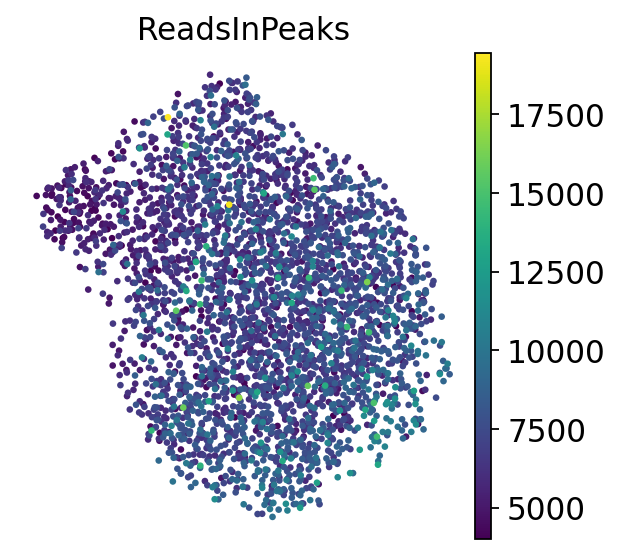

In [67]:
sc.pl.umap(adata_mvi,color=['ReadsInPeaks'],frameon = False)

## visualize LF

In [68]:
### store the latent representations, latent denoms and library size of the autoencoder models
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()

# for i in range(10):
#     adata_mvi.obs["epxr_latent_"+str(i)] = min_max_scaler.fit_transform(latent_expr[:,i].reshape(1,-1))[0,:]

# for i in range(10):
#     adata_mvi.obs["atac_latent_"+str(i)] =  min_max_scaler.fit_transform(latent_acc[:,i].reshape(1,-1))[0,:]

for i in range(30):
    adata_mvi.obs["epxr_latent_"+str(i)] = latent_expr[:,i]

for i in range(30):
    adata_mvi.obs["atac_latent_"+str(i)] =  latent_acc[:,i]    

In [73]:
latentname = ["epxr_latent_"+str(i) for i in range(30)]

In [31]:
adata_mvi

AnnData object with n_obs × n_vars = 3370 × 91583
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters', 'GATA3_norm2', '_scvi_batch', '_scvi_labels', 'latent_expr_0', 'latent_atac_0', 'latent_expr_1', 'latent_atac_1', 'latent_expr_2', 'latent_atac_2', 'latent_expr_3', 'latent_atac_3', 'latent_expr_4', 'latent_atac_4', 'latent_expr_5', 'latent_atac_5', 'latent_expr_6', 'latent_atac_6', 'latent_expr_7', 'latent_atac_7', 'latent_expr_8', 'latent_atac_8', 'latent_

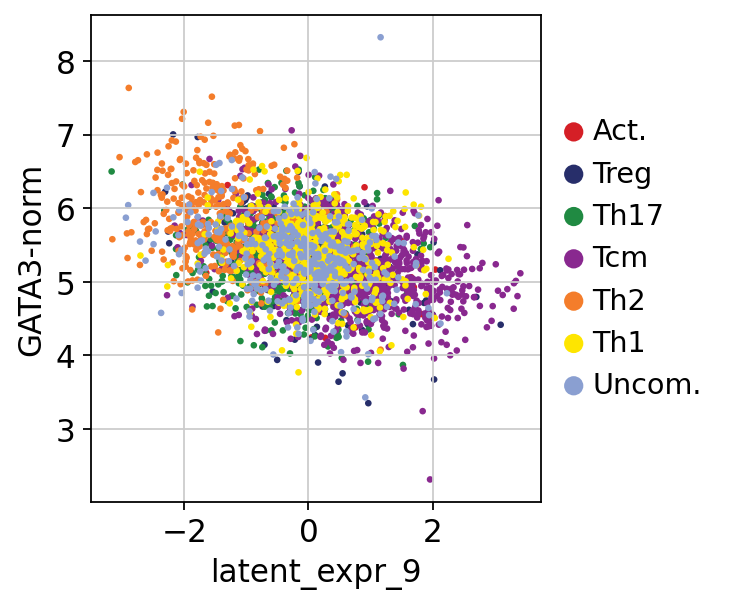

(-0.4043175157958716, 9.71410323616e-133)


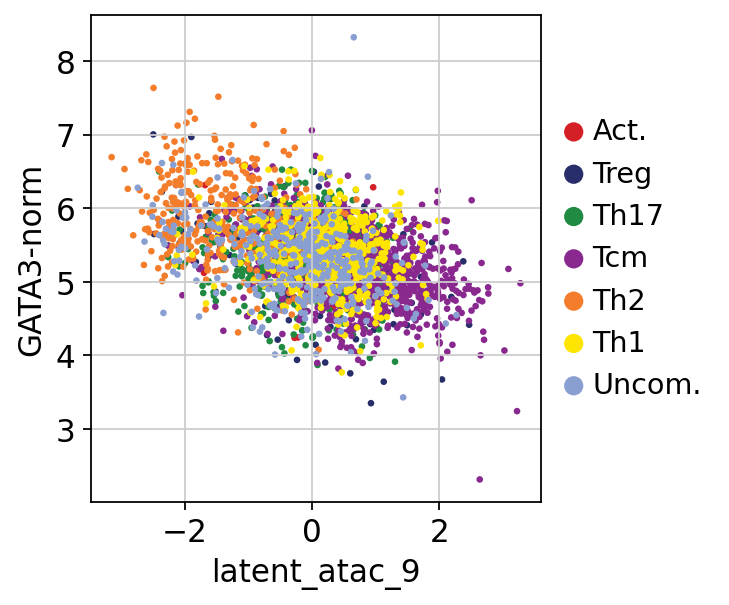

(-0.43331474865242536, 2.5576557063204536e-154)


In [50]:
# sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = latentname[21],color='new_clusters',
# title = '',frameon = False,)

# print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs[latentname[21]]))

path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
sc.set_figure_params(vector_friendly=True)

adata_mvi.obs["latent_expr_9"] =  latent_expr[:,9]

adata_mvi.obs["latent_atac_9"] =  latent_acc[:,9]


save = "latent_expr_9_corr.pdf"
# save = path2figdir + save
sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = "latent_expr_9",color='new_clusters',
title = '',frameon = False, save=save)

print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs["latent_expr_9"]))

save = "latent_atac_9_corr.pdf"
# save = path2figdir + save
sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = "latent_atac_9",color='new_clusters',
title = '',frameon = False, save=save)

print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs["latent_atac_9"]))

In [14]:
rnaloading = model.get_rna_loading()
rnaloading = rnaloading.T

In [15]:

topgenes_latent = model.get_top_genes(200, loadingmatrix=rnaloading, latent_index=9, \
    rnadata =rna_data,colname="index")
    

In [16]:

for e in topgenes_latent[::-1]:
    print(e) 

LAMTOR5-AS1
AGFG1
MED26
LMF1
SCRN2
SUB1
BIK
AGK
ZNF579
PLAC1
RNF26
CENPI
ZNF737
ZNF852
FAM117B
GHDC
SRP14-AS1
LLGL2
USE1
AC104850.2
AL358944.1
AC020651.2
COMMD8
CIAPIN1
SERINC1
AC103591.3
USP48
SPAG5
PRDM10
CNGB3
CARD19
C22orf24
AL121929.3
LRMP
AC113414.1
SIGIRR
SNU13
SETD3
PRRC2B
SLC12A1
CCDC146
MFSD4B
AL137779.2
ELOVL4
LCP1
PLA2G4B
MAP4K3-DT
ZNF226
SSR1
MRPS23
EXOSC9
SLC35F1
CD83
TXNDC16
CACNB3
ZBED1
ARAF
DNAJC6
CAND1
BAZ2B
INO80
MAN1B1
REEP5
TBC1D22B
YTHDF2
RGS6
IL1RAPL1
CSF1
CFAP36
EXOC8
DCAF8
NTRK2
AL589693.1
LINC00641
ZNF90
COA4
HORMAD2
GASK1B
ERAP1
TSR3
TMEM50A
AC005726.5
CD40LG
CPOX
TIAM2
AL513314.2
C1QTNF6
ACLY
COQ7
DESI1
MTMR10
MARCH6
GTF2H5
AC109927.1
COX6A1
ABHD14B
BRI3BP
LSM2
FAM189B
ARL13B
P2RY14
SLC25A45
ETHE1
CNGA1
SLC35A5
CCS
CD38
U2SURP
ENAH
AC104041.1
AC009554.1
Z83844.2
SIAH2-AS1
VPS16
RRM2B
RNF125
NFKBIL1
CEP164
LTV1
TMC1
SEC31A
CAP1
ZCWPW2
SCRN3
MYCBP2
REXO1
HCFC1R1
LINC02580
GIT2
P4HA3
SLC6A15
ZSWIM5
BLOC1S2
SPICE1
CDC16
STK26
TMEM175
HEXIM1
MAGI2
CLYBL
PPP1R16B


In [57]:
rna_data.var

,gene_ids,feature_types,n_cells,modality,highly_variable,means,dispersions,dispersions_norm,exog,endog
AL627309.5,ENSG00000241860,Gene Expression,36,Gene Expression,True,0.057429,2.028981,1.679020,True,True
LINC01409,ENSG00000237491,Gene Expression,76,Gene Expression,False,0.109307,1.750434,-0.082029,False,False
LINC01128,ENSG00000228794,Gene Expression,65,Gene Expression,True,0.097623,1.850665,0.551656,True,False
LINC00115,ENSG00000225880,Gene Expression,26,Gene Expression,False,0.038147,1.691563,-0.454231,False,False
NOC2L,ENSG00000188976,Gene Expression,49,Gene Expression,False,0.071577,1.695032,-0.432295,False,False
...,...,...,...,...,...,...,...,...,...,...
MT-ND6,ENSG00000198695,Gene Expression,138,Gene Expression,False,0.181096,1.668814,-0.598052,False,False
MT-CYB,ENSG00000198727,Gene Expression,2754,Gene Expression,False,2.382078,1.962024,-0.872572,False,False
AL354822.1,ENSG00000278384,Gene Expression,13,Gene Expression,False,0.018021,1.588328,-1.106908,False,False
AL592183.1,ENSG00000273748,Gene Expression,266,Gene Expression,False,0.355011,1.824808,-0.198687,False,False


In [58]:
adata_mvi.var

,gene_ids,feature_types,n_cells,modality
AL627309.5,ENSG00000241860,Gene Expression,36,Gene Expression
LINC01409,ENSG00000237491,Gene Expression,76,Gene Expression
LINC01128,ENSG00000228794,Gene Expression,65,Gene Expression
LINC00115,ENSG00000225880,Gene Expression,26,Gene Expression
NOC2L,ENSG00000188976,Gene Expression,49,Gene Expression
...,...,...,...,...
chrX-155279869-155280369,chrX-155279869-155280369,Peaks,18,Peaks
chrX-155612706-155613206,chrX-155612706-155613206,Peaks,48,Peaks
chrX-155632526-155633026,chrX-155632526-155633026,Peaks,70,Peaks
chrX-155767205-155767705,chrX-155767205-155767705,Peaks,19,Peaks


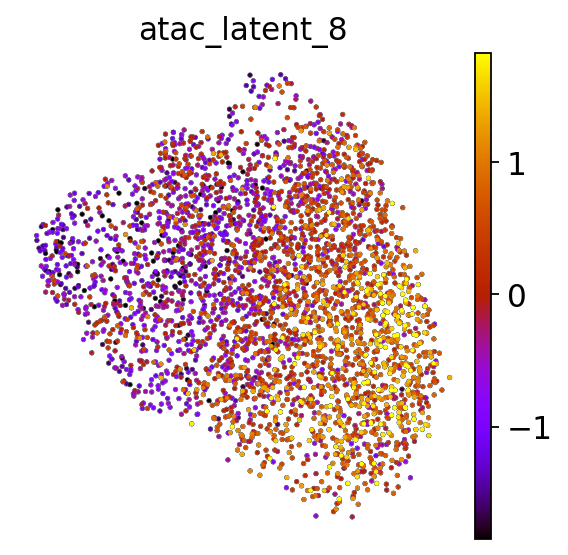

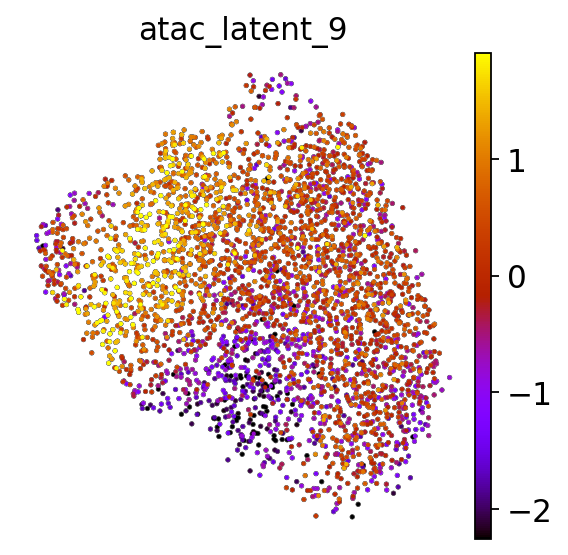

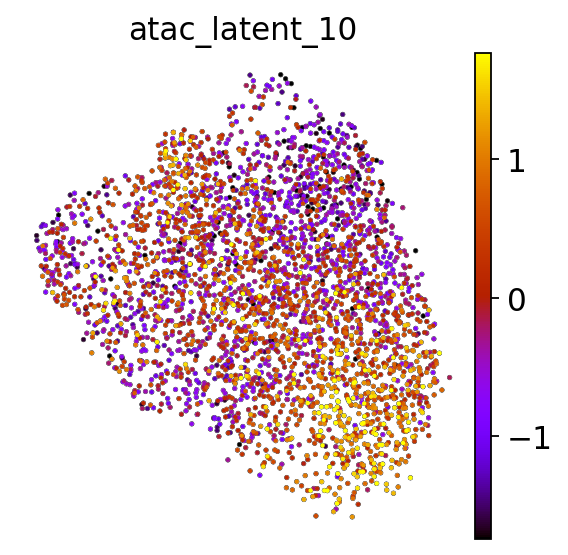

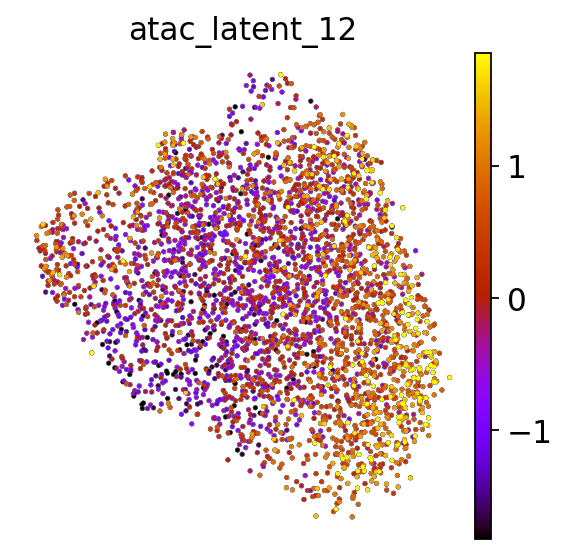

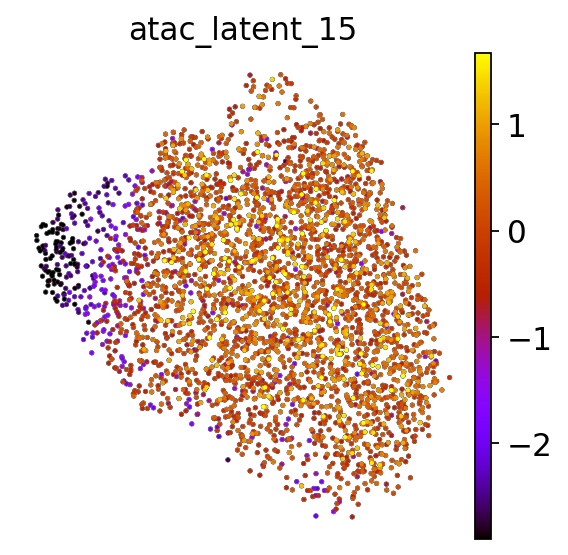

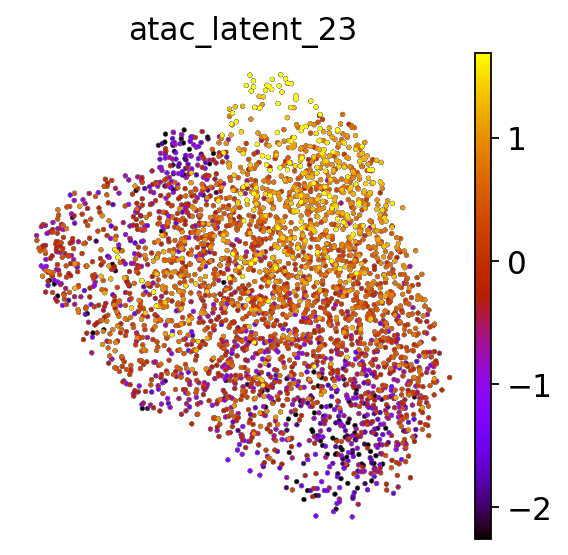

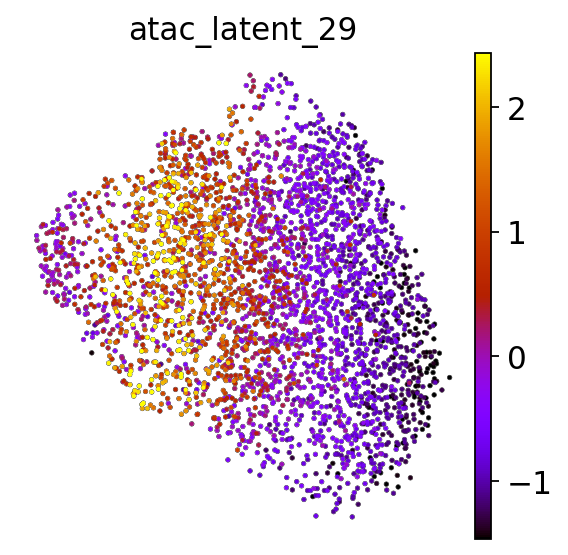

In [89]:
figure_name = "_atac_latent_8"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[8],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_9"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[9],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_10"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[10],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_12"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[12],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_15"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[15],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path) 


figure_name = "_atac_latent_23"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[23],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_29"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[29],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   

In [ ]:
sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = latentname[3],color='new_clusters',
title = '',frameon = False,)
adata_mvi.obs['GATA3-norm'].corr(adata_mvi.obs[latentname[3]])
print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs[latentname[3]]))

In [66]:
a = [1,2,3,4]
a[-2:]

[3, 4]

In [90]:
rnaloading = model.get_rna_loading()
rnaloading = rnaloading.T

[Text(0.5, 20.777777777777786, 'genes')]

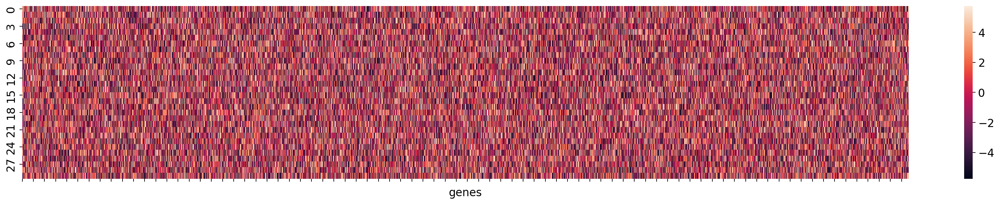

In [91]:
plt.figure(figsize=(25,4))
hm = sns.heatmap(rnaloading)
hm.set(xticklabels=[]) 
hm.set(xlabel="genes")

In [92]:
## get RNA data
from complementary_models import split_rna
rna_data = split_rna(adata_mvi=adata_mvi)

In [94]:
rna_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF.h5ad")

## get the highly variable genes for LF (RNA)

In [95]:
rna_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF.h5ad")

In [96]:
# sc.pp.filter_genes(rna_data, min_cells=15)
rna_data.raw = rna_data
## normlaize the read depths of each cell, then logarithmize the data:
sc.pp.normalize_total(rna_data, target_sum=1e4)
sc.pp.log1p(rna_data)
# Calculate highly variable genes, but with a less stringent dispersion threshold. This set of genes will be our “exogenous” genes:
sc.pp.highly_variable_genes(rna_data, min_disp = 0.2, n_top_genes=None)
rna_data.var['exog'] = rna_data.var.highly_variable.copy()
# Finally, calculate the “endogenous” geneset by intersecting the exogenous set with genes with a higher dispersion threshold:
rna_data.var['endog'] = rna_data.var.exog & (rna_data.var.dispersions_norm > 0.7)
# Restore the raw counts to the counts layer.
rna_data.layers['counts'] = rna_data.raw.to_adata().X.copy()

In [97]:
## add the latent features of model
rna_data.obsm["X_topic_compositions"] = latent_expr

In [98]:
# for i in range(0, 30):
#     print(i),
#     topgenes_latent = model.get_top_genes(100, loadingmatrix=rnaloading, latent_index=i, \
#     rnadata =rna_data,colname="index") # gene names are saved as the adata.var index
#     name = "./data/datasets/NEAT_Seq/RNA_feature/NEAT_seq_latent_{}_genes.txt".format(str(i))
#     np.savetxt(name,np.array(topgenes_latent), fmt='%s')


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


In [29]:
for i in range(0, 30):
    print(i),
    topgenes_latent = model.get_top_genes(200, loadingmatrix=rnaloading, latent_index=i, \
    rnadata =rna_data,colname="index") # gene names are saved as the adata.var index
    name = "./figs/NEAT_seq_30LF/RNA_feature/NEAT_seq_latent_{}_genes.txt".format(str(i))
    np.savetxt(name,np.array(topgenes_latent), fmt='%s')


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


In [30]:
topgenes_latent_1 = model.get_top_genes(200, loadingmatrix=rnaloading, latent_index=9, rnadata =rna_data,colname="index") # gene names are saved as the adata.var index

In [31]:
## get post gene_list
from tools.enrichment import get_post_genelist, fetch_genelist_enrichments
post_genelist = get_post_genelist(topgenes_latent_1)
results = fetch_genelist_enrichments(post_genelist)

In [32]:
results["results"].keys()

dict_keys(['WikiPathways_2019_Human', 'WikiPathways_2019_Mouse', 'KEGG_2019_Human', 'KEGG_2019_Mouse', 'GO_Molecular_Function_2018', 'GO_Cellular_Component_2018', 'GO_Biological_Process_2018', 'BioPlanet_2019'])

In [33]:
results

{'list_id': 65945119,
 'results': {'WikiPathways_2019_Human': [{'rank': 1,
    'term': 'Heme Biosynthesis WP561',
    'pvalue': 0.0034202318391573132,
    'zscore': 28.561327561327563,
    'combined_score': 162.17255858986445,
    'genes': ['UROS', 'CPOX'],
    'adj_pvalue': 0.5137769980421546},
   {'rank': 2,
    'term': 'NO/cGMP/PKG mediated Neuroprotection WP4008',
    'pvalue': 0.01156531191621091,
    'zscore': 6.83756345177665,
    'combined_score': 30.49378950483647,
    'genes': ['CNGA1', 'CNGB3', 'NFKB1'],
    'adj_pvalue': 0.5137769980421546},
   {'rank': 3,
    'term': 'Apoptosis Modulation and Signaling WP1772',
    'pvalue': 0.013195970913978198,
    'zscore': 4.62420830401126,
    'combined_score': 20.012850913677784,
    'genes': ['AIFM2', 'BIK', 'RIPK1', 'NFKB1'],
    'adj_pvalue': 0.5137769980421546},
   {'rank': 4,
    'term': 'Apoptosis Modulation by HSP70 WP384',
    'pvalue': 0.015214448401771344,
    'zscore': 11.754604872251932,
    'combined_score': 49.199013298

In [106]:
def raw_umap(
            ncols = 8,
            frameon=False, 
            color_map = 'Blues', 
            add_outline = True, 
            outline_color = ('black','lightgrey'), 
            outline_width = (0, 0.5), 
            size = 30):

    return dict(
        ncols = ncols, frameon = frameon, color_map = color_map,
        add_outline = add_outline, outline_color = outline_color, 
        outline_width = outline_width, size = size
    )

In [107]:
rna_data.obsm["X_topic_compositions"] = latent_expr
rna_data.obsm["X_umap"] = adata_mvi.obsm['X_umap']

In [108]:
sub = rna_data.var.loc[topgenes_latent, :]
latent_genes = sub[sub.highly_variable == True].index.tolist()

In [117]:
figure_name = "_RNA_latent_3_topgenes"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(rna_data, color=topgenes_latent_1, **raw_umap(ncols=5, size=75, color_map="Blues", outline_width=(0, 0.5)),
vmin='p2', vmax='p98', save=save_path,
show=False, colorbar_loc=None) 

[<AxesSubplot:title={'center':'SKAP2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'ABCF2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TERC'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TRAPPC3'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TAF1B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'NEUROD2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GARS'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'SFMBT2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'EAF1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'PPP1R16B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CLYBL'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'MAGI2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'HEXIM1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TMEM175'}, xla

In [ ]:
# MAPK signaling pathway
sc.pl.umap(rna_data, color=['NTRK2', 'CACNB3', 'CSF1', 'PLA2G4B', 'ARAF'], **raw_umap(ncols=5, size=75, color_map="Blues", outline_width=(0, 0.5)),
# vmin='p1', vmax='p99', 
show=False, colorbar_loc=None) 

In [123]:
LF9_genes_selected = ['LRMP','RRM2B','BAZ2B']
figure_name = "_RNA_latent_9_topgenes_selected"
format = ".pdf"
save_path = figure_name+format
sc.pl.umap(rna_data, color=LF9_genes_selected, **raw_umap(ncols=3, size=75, color_map="Blues", outline_width=(0, 0.5)),
vmin='p1', vmax='p99', save=save_path,show=False, colorbar_loc=None) 


[<AxesSubplot:title={'center':'LRMP'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'RRM2B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'BAZ2B'}, xlabel='UMAP1', ylabel='UMAP2'>]

In [118]:
rna_data

AnnData object with n_obs × n_vars = 3370 × 13380
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters', '_scvi_batch', '_scvi_labels', 'epxr_latent_0', 'epxr_latent_1', 'epxr_latent_2', 'epxr_latent_3', 'epxr_latent_4', 'epxr_latent_5', 'epxr_latent_6', 'epxr_latent_7', 'epxr_latent_8', 'epxr_latent_9', 'epxr_latent_10', 'epxr_latent_11', 'epxr_latent_12', 'epxr_latent_13', 'epxr_latent_14', 'epxr_latent_15', 'epxr_latent_16', 'epxr_latent_17', 'epxr_latent_18

In [134]:
rna_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF_v1.h5ad")

## ATAC LF

In [8]:
## split the atac data
from complementary_models import split_atac, reindex_atac

atac_data = split_atac(adata_mvi=adata_mvi)
# atac_data = reindex_atac(atac_data)

In [9]:
atac_data.var.index.names = ["Id"]
atac_data.var.index = atac_data.var.index.astype(str)
atac_data.var

,gene_ids,feature_types,n_cells,modality
Id,,,,
chr1-817095-817595,chr1-817095-817595,Peaks,45,Peaks
chr1-827298-827798,chr1-827298-827798,Peaks,153,Peaks
chr1-844407-844907,chr1-844407-844907,Peaks,45,Peaks
chr1-857908-858408,chr1-857908-858408,Peaks,16,Peaks
chr1-869618-870118,chr1-869618-870118,Peaks,133,Peaks
...,...,...,...,...
chrX-155279869-155280369,chrX-155279869-155280369,Peaks,18,Peaks
chrX-155612706-155613206,chrX-155612706-155613206,Peaks,48,Peaks
chrX-155632526-155633026,chrX-155632526-155633026,Peaks,70,Peaks


In [10]:
split = atac_data.var_names.str.split(r"[-]")
split

atac_data.var["chr"] = split.map(lambda x: x[0])
atac_data.var["begin"] = split.map(lambda x: x[1]).astype(int)
atac_data.var["end"] = split.map(lambda x: x[2]).astype(int)
atac_data.var.head()


,gene_ids,feature_types,n_cells,modality,chr,begin,end
Id,,,,,,,
chr1-817095-817595,chr1-817095-817595,Peaks,45,Peaks,chr1,817095,817595
chr1-827298-827798,chr1-827298-827798,Peaks,153,Peaks,chr1,827298,827798
chr1-844407-844907,chr1-844407-844907,Peaks,45,Peaks,chr1,844407,844907
chr1-857908-858408,chr1-857908-858408,Peaks,16,Peaks,chr1,857908,858408
chr1-869618-870118,chr1-869618-870118,Peaks,133,Peaks,chr1,869618,870118


In [11]:
atac_data.var = atac_data.var.rename(columns={"begin":"start"})


In [12]:
# atac_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim.h5ad")
atac_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_1.h5ad")



## change the virtual environment HALO2 (TSS information)

In [1]:
import mira
import anndata
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import tools
warnings.simplefilter("ignore")

mira.datasets.PseudotimeTrajectoryInferenceTutorial()
atac_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_1.h5ad")
mira.utils.pretty_sderr()


INFO:mira.datasets.datasets:Dataset already on disk.
INFO:mira.datasets.datasets:Dataset contents:
	* mira-datasets/shareseq.hair_follicle.joint_representation.h5ad


In [2]:
atac_data

AnnData object with n_obs × n_vars = 3370 × 78203
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters'
    var: 'gene_ids', 'feature_types', 'n_cells', 'modality', 'chr', 'start', 'end'

In [2]:
# dowdload reference genome to annotate transcription factor binding sites

# !wget https://hgdownload.soe.ucsc.edu/goldenPath/hg38/bigZips/hg38.fa.gz 
# !gzip -d -f hg38.fa.gz

In [3]:
import tools
import logging
tools.motif_scan.logger.setLevel(logging.INFO)
tools.get_motif_hits_in_peaks(atac_data,
                    genome_fasta='hg38.fa',species="all",
                    chrom = 'chr', start = 'start', end = 'end')

INFO:tools.motif_scan:Getting peak sequences ...
78203it [00:01, 76404.83it/s]
INFO:tools.motif_scan:Scanning peaks for motif hits with p >= 0.0001 ...
INFO:tools.motif_scan:Building motif background models ...
INFO:tools.motif_scan:Starting scan ...
INFO:tools.motif_scan:Found 1000000 motif hits ...
INFO:tools.motif_scan:Found 2000000 motif hits ...
INFO:tools.motif_scan:Found 3000000 motif hits ...
INFO:tools.motif_scan:Found 4000000 motif hits ...
INFO:tools.motif_scan:Found 5000000 motif hits ...
INFO:tools.motif_scan:Found 6000000 motif hits ...
INFO:tools.motif_scan:Found 7000000 motif hits ...
INFO:tools.motif_scan:Found 8000000 motif hits ...
INFO:tools.motif_scan:Found 9000000 motif hits ...
INFO:tools.motif_scan:Formatting hits matrix ...
INFO:tools.regulators:Added key to varm: motifs_hits
INFO:tools.regulators:Added key to uns: motifs


In [4]:
atac_data.uns

OverloadedDict, wrapping:
	OrderedDict([('motifs', {'id': ['MA0483.1', 'MA0885.1', 'MA0677.1', 'MA0117.2', 'MA0858.1', 'MA0883.1', 'MA0611.1', 'MA0494.1', 'MA0622.1', 'MA1629.1', 'MA0880.1', 'MA1603.1', 'MA1630.1', 'MA0857.1', 'MA0521.1', 'MA0591.1', 'MA0519.1', 'MA1624.1', 'MA0125.1', 'MA0704.1', 'MA1625.1', 'MA0853.1', 'MA0860.1', 'MA0816.1', 'MA0911.1', 'MA1684.1', 'MA1604.1', 'MA0122.3', 'MA1606.1', 'MA0480.1', 'MA0720.1', 'MA0705.1', 'MA0065.2', 'MA0029.1', 'MA1627.1', 'MA1628.1', 'MA1621.1', 'MA0146.2', 'MA0135.1', 'MA0602.1', 'MA0078.1', 'MA0728.1', 'MA0514.1', 'MA0626.1', 'MA0739.1', 'MA0505.1', 'MA0520.1', 'MA0614.1', 'MA0643.1', 'MA0067.1', 'MA0869.1', 'MA0676.1', 'MA0608.1', 'MA0515.1', 'MA0859.1', 'MA0615.1', 'MA0603.1', 'MA0150.2', 'MA0601.1', 'MA0518.1', 'MA0897.1', 'MA0467.1', 'MA0004.1', 'MA0503.1', 'MA0164.1', 'MA0896.1', 'MA0879.1', 'MA0006.1', 'MA0142.1', 'MA0512.2', 'MA1153.1', 'MA0493.1', 'MA1607.1', 'MA0633.1', 'MA0742.1', 'MA0854.1', 'MA1619.1', 'MA0152.1', 'MA16

In [6]:
atac_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_motif.h5ad")

## Back to HALO environment (Motif Enrichment)

In [1]:
from typing import Dict, Iterable, Optional

import numpy as np
import torch
import scanpy as sc

from torch.distributions import Normal, Poisson
from torch.distributions import kl_divergence as kld
from torch import tensor
from complementary_models import HALOMASKVIR as HALOVI
from complementary_models import HALOMASKVAE as HALOVAE
import scvi
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import scipy


Global seed set to 0
/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/torch/cuda/__init__.py:83: UserWarning: CUDA initialization: CUDA unknown error - this may be due to an incorrectly set up environment, e.g. changing env variable CUDA_VISIBLE_DEVICES after program start. Setting the available devices to be zero. (Triggered internally at  /opt/conda/conda-bld/pytorch_1659484775609/work/c10/cuda/CUDAFunctions.cpp:109.)
  return torch._C._cuda_getDeviceCount() > 0


In [2]:
adata_mvi = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/multiome_interim.h5ad")

HALOVI.setup_anndata(adata_mvi, batch_key="modality", time_key='GATA3-norm')
model = HALOVI(
    adata_mvi,
    n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
    n_layers = 2,
    n_latent = 30,
    n_dependent=15
)


self.w_a :1
yes there is aligner


In [3]:
# model = model.load("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000",adata_mvi)
model = model.load("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_ALN_BEST",adata_mvi)

INFO     File model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_ALN_BEST/model.pt already 
         downloaded                                                                          
self.w_a :0
no there is no aligners


In [4]:
loadings = model.get_atac_loading()
print(loadings.shape)
loadings = loadings.T

(78203, 30)


In [5]:
atac_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_motif.h5ad")

In [18]:
import matplotlib.pyplot as plt

def compare_latent_TFs(l1=0, l2=5,size=50, pval_thresh = (1e-100, 1e-20)):
    latent_l1_tf, index_learnt = model.get_enriched_TFs(atac_data, topic_num=l1, top_quantile=6e-6, loadings=loadings, num_exo_features=1e6)
    latent_l2_tf, index_learnt = model.get_enriched_TFs(atac_data, topic_num=l2, top_quantile=6e-6, loadings=loadings, num_exo_features=1e6)

    # latent_l1_tf, index_learnt = model.get_enriched_TFs(atac_data, topic_num=l1, top_quantile=1e-5, loadings=loadings, num_exo_features=1e6)
    # latent_l2_tf, index_learnt = model.get_enriched_TFs(atac_data, topic_num=l2, top_quantile=1e-5, loadings=loadings, num_exo_features=1e6)
    model.plot_compare_topic_enrichments(l1, l2, pval_threshold=pval_thresh, color="lightgray", size=size)



Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

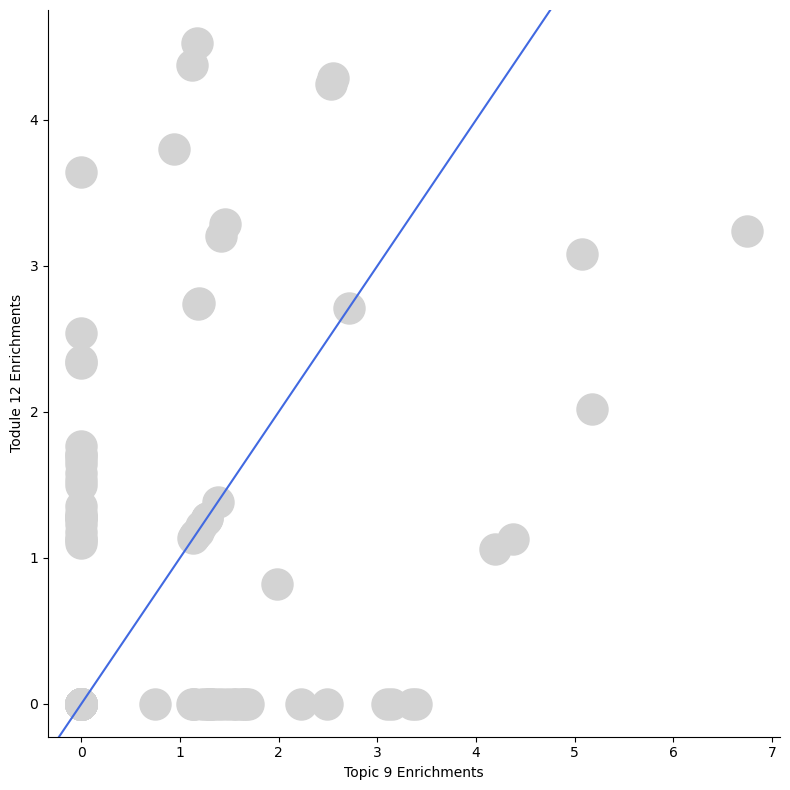

In [19]:
compare_latent_TFs(9,12, size=500)
plt.savefig("figs/NEAT_seq_30LF/TF_9_12_unlabel.pdf", dpi=300)

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

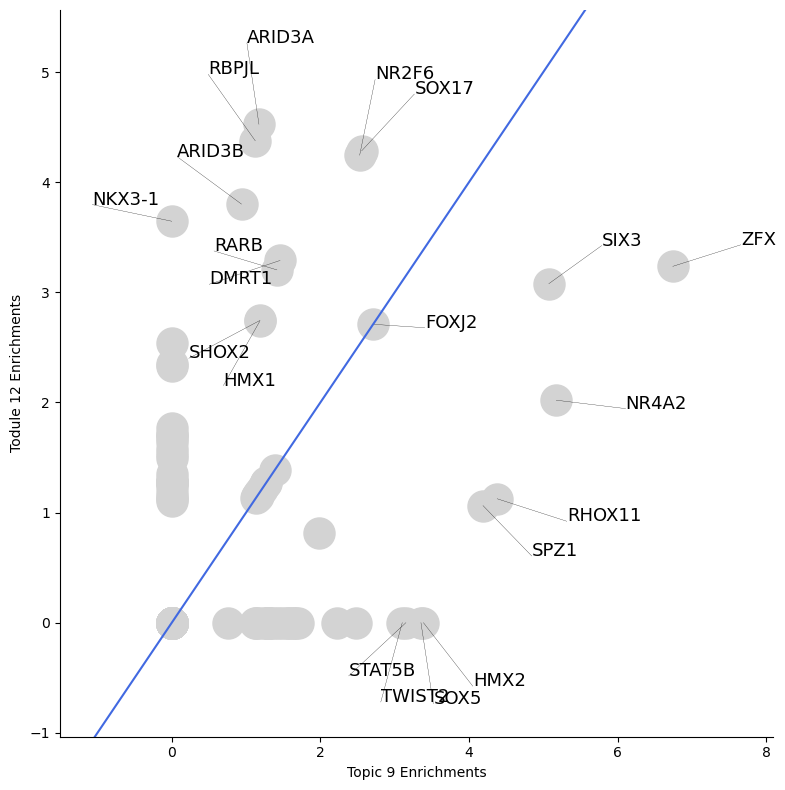

In [20]:
compare_latent_TFs(9,12, size=500, pval_thresh=(1e-3, 1e-3))
plt.savefig("figs/NEAT_seq_30LF/TF_9_12_label.pdf", dpi=300)

In [ ]:
m1 = model.get_enrichments(9, factor_type = 'motifs')
m2 = model.get_enrichments(8, factor_type = 'motifs')  

<AxesSubplot:xlabel='Latent 9 Enrichments', ylabel='Latent 8 Enrichments'>

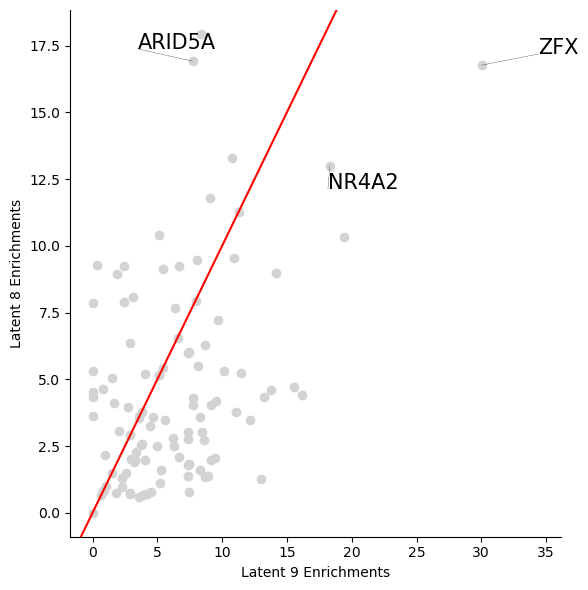

In [8]:
model.plot_compare_topic_enrichments(9, 8, pval_threshold=(1e-50, 1e-50), label_factors = ['ARID5A','NR4A2','ZFX'],
figsize = (6,6),fontsize = 15,label_closeness =3, max_label_repeats = 3,color = 'lightgrey')

In [21]:
pwd

'/home/haiyi/Desktop/HierachicalCausal_Omics'

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

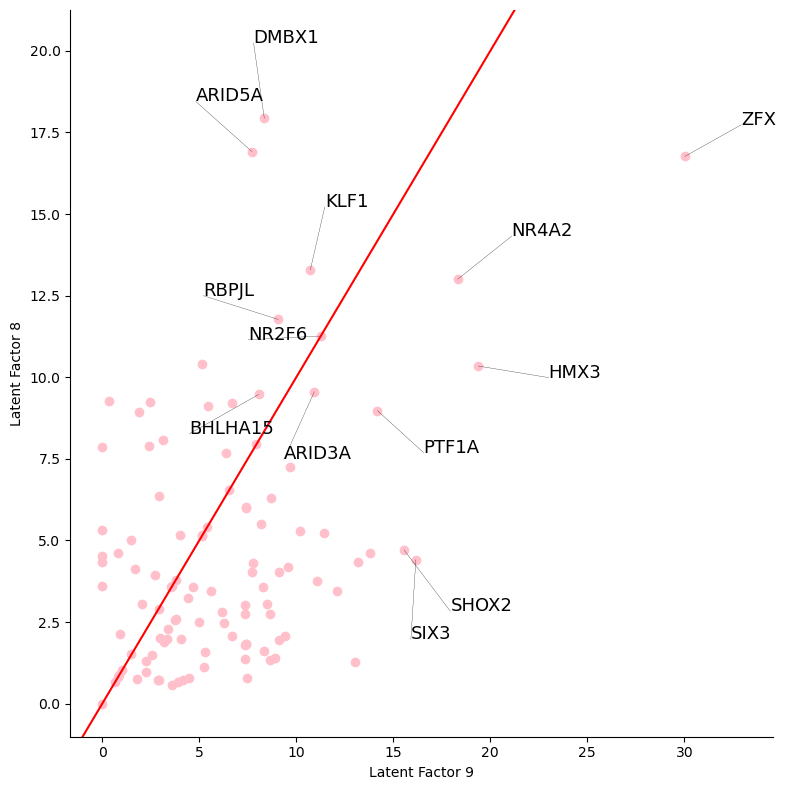

In [13]:
compare_latent_TFs(9,8)